## Import

In [1]:
import mne
import numpy as np
import scipy
import os
import math
import pandas as pd
from scipy import signal as sg
from matplotlib import pyplot as plt
from mne.preprocessing import ICA, create_ecg_epochs, create_eog_epochs

## Load Data

In [2]:
directory_path = "D:/EEG RESEARCH DATA"
os.chdir(directory_path)

raw = mne.io.read_raw_brainvision("20231019_B68_stroopv1/20231019_B68_stroopv1_0001.vhdr")

# Reconstruct the original events from our Raw object
events, event_ids = mne.events_from_annotations(raw)

Extracting parameters from 20231019_B68_stroopv1/20231019_B68_stroopv1_0001.vhdr...
Setting channel info structure...
Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1']


In [3]:
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_channel_types({'ECG':'ecg'})
raw.set_channel_types({'vEOG':'eog'})
raw.set_channel_types({'hEOG':'eog'})

<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 958600 (958.6 s), ~72 kB, data not loaded>

In [4]:
raw.set_montage(montage)
#fig = raw.plot_sensors(show_names=True)

<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 958600 (958.6 s), ~98 kB, data not loaded>

### Segment Grouping

In [5]:
fs = 1000

trg0 = events[9,0] #Experiment Begin 
trg1 = events[10,0] #Task Begin
trg2 = events[-2,0] #Task End
trg3 = events[-1,0] #Experiment End

tmin = trg0/fs
tmax = trg3/fs

# #Segment in Samples
# seg1 = trg1 - trg0
# seg2 = trg2 - trg0
# seg3 = trg3 - trg0

# #Segment in ms
# newseg1 = int(seg1/fs)
# newseg2 = int(seg2/fs)
# newseg3 = int(seg3/fs)

## ECG Analysis

### Using My Pan Tompkins Algorithm

In [6]:
##Testing only on ECG, T = 60 secs
#raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = 60, tmax = 120) #make a copy


#Testing only on ECG, T = Whole experiment actual time
raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = tmin, tmax = tmax) #make a copy

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [7]:
mne_ecg, mne_time = raw_ecg[:]
mne_ecg = -mne_ecg.T

####  Pan Tompkins Alogrithm

In [8]:
class pan_tompkins_qrs():
    def bpf(self,x):
        
        
        
        y_filtered = None

        #Results will be delayed 16 Samples
        y = x.copy()

        #Low Pass Filter
        #y(n) = 2y(n-1) - y(n-2) + x(n) - 2x(n-6) + x(n-12)
        for n in range(len(x)):
            y[n] = x[n]

            if (n >= 1):
                y[n] += 2*y[n-1]
            if (n >= 2):
                y[n] -= y[n-2]
            if (n >= 6):
                y[n] -= 2*x[n-6]
            if (n >= 12):
                y[n] += x[n-12]
        
        y_filtered = y.copy()

        #High Pass Filter
        #y(n) = 32x(n-16) - y(n-1) - x(n) + x(n-32)
        for n in range(len(x)):
            y_filtered[n] = -1*y[n]

            if (n >= 1):
                y_filtered[n] -= y_filtered[n-1]
            if (n >= 16):
                y_filtered[n] += 32*y[n-16]
            if(n >= 32):
                y_filtered[n] += y[n-32]
        
        #Normalization
        max_val = max(max(y_filtered), -min(y_filtered))
        y_filtered = y_filtered/max_val

        return y_filtered
    
    def derivative(self,x,fs):
        
        #Results will be delayed for 2 samples
        y_derived = x.copy()
        
        #Derivative Filter
        #y(n) = [-x(n-2) - 2x(n-1) + 2x(n+1) + x(n+2)]/8
        for n in range(len(x)):
            y_derived[n] = 0

            if (n >= 1):
                y_derived[n] -= 2*x[n-1]
            if (n >= 2):
                y_derived[n] -= x[n-2]
            
            ###Not sure what this part is for###
            if (n >= 2 and n <= len(x)-2):
                y_derived[n] += 2*x[n+1]
            if (n >= 2 and n<= len(x)-3):
                y_derived[n] += x[n+2]
            ###Not sure what this part is for###

            ###Not sure why does it has to be times to "fs"###
            y_derived[n] = (y_derived[n]*fs)/8
            ###Not sure why does it has to be times to "fs"###
        
        return y_derived
    
    def squaring(self,x):
        
        y_squared = x.copy()

        for n in range(len(x)):
            y_squared[n] = x[n]**2

        return y_squared
    
    def moving_window_integration(self,x,fs):
        # Initialize result and window size for integration
        y = x.copy()
        win_size = round(0.150 * fs)
        sum = 0

        # Calculate the sum for the first N terms
        for j in range(win_size):
            sum += x[j]/win_size
            y[j] = sum
        
        # Apply the moving window integration using the equation given
        for n in range(win_size,len(x)):  
            sum += x[n]/win_size
            sum -= x[n-win_size]/win_size
            y[n] = sum

        return y

    def solve(self,x,fs):

        # Convert the input signal into numpy array
        input_signal = x.copy()

        # Bandpass Filter
        global bpass
        bpass = self.bpf(input_signal.copy())

        # Derivative Function
        global der
        der = self.derivative(bpass.copy(),fs)

        # Squaring Function
        global sqr
        sqr = self.squaring(der.copy())

        # Moving Window Integration Function
        global mwin
        mwin = self.moving_window_integration(sqr.copy(),fs)

        return mwin


In [9]:
class heart_rate():
    def __init__(self,x,fs):
        #Initialize Variables
        self.RR1, self.RR2, self.probable_peaks, self.r_locs, self.peaks, self.result = ([] for i in range(6))
        self.SPKI, self.NPKI, self.Threshold_I1, self.Threshold_I2, self.SPKF, self.NPKF, self.Threshold_F1, self.Threshold_F2 = (0 for i in range(8))

        self.T_wave = False
        self.m_win = mwin
        self.b_pass = bpass
        self.fs = fs
        self.signal = x
        self.win_150ms = round(0.15*self.fs)

        self.RR_Low_Limit = 0
        self.RR_High_Limit = 0
        self.RR_Missed_Limit = 0
        self.RR_Average1 = 0

    def approx_peak(self):
        ###Change from the original code by making the size to (A x 1) instead of (A x )###
        slopes = sg.fftconvolve(self.m_win, np.full((25,1),1)/25, mode='same')
        ###Change from the original code by making the size to (A x 1) instead of (A x )###

        # for i in range(round(0.5*self.fs) + 1,len(slopes)-1):
        for i in range(0,len(slopes)-1):
            if (slopes[i] > slopes[i-1]) and (slopes[i+1] <slopes[i]):
                self.peaks.append(i)

    def adjust_rr_interval(self, ind):
        self.RR1 = np.diff(self.peaks[max(0,ind - 8) : ind + 1])/self.fs  

        # Calculating RR Averages
        self.RR_Average1 = np.mean(self.RR1)
        RR_Average2 = self.RR_Average1
        
        # Finding the eight most recent RR intervals lying between RR Low Limit and RR High Limit  
        if (ind >= 8):
            for i in range(0, 8):
                if (self.RR_Low_Limit < self.RR1[i] < self.RR_High_Limit): 
                    self.RR2.append(self.RR1[i])

                    if (len(self.RR2) > 8):
                        self.RR2.remove(self.RR2[0])
                        RR_Average2 = np.mean(self.RR2)    

        # Adjusting the RR Low Limit and RR High Limit
        if (len(self.RR2) > 7 or ind < 8):
            self.RR_Low_Limit = 0.92 * RR_Average2        
            self.RR_High_Limit = 1.16 * RR_Average2
            self.RR_Missed_Limit = 1.66 * RR_Average2
    
    def searchback(self, peak_val, RRn, sb_win):
        # Check if the most recent RR interval is greater than the RR Missed Limit
        if (RRn > self.RR_Missed_Limit):
            # Initialize a window to searchback  
            win_rr = self.m_win[peak_val - sb_win + 1 : peak_val + 1] 

            # Find the x locations inside the window having y values greater than Threshold I1             
            coord = np.asarray(win_rr > self.Threshold_I1).nonzero()[0]

            # Find the x location of the max peak value in the search window
            if (len(coord) > 0):
                for pos in coord:
                    if (win_rr[pos] == max(win_rr[coord])):
                        x_max = pos
                        break
            else:
                x_max = None
    
            # If the max peak value is found
            if (x_max is not None):   
                # Update the thresholds corresponding to moving window integration
                self.SPKI = 0.25 * self.m_win[x_max] + 0.75 * self.SPKI                         
                self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
                self.Threshold_I2 = 0.5 * self.Threshold_I1         

                # Initialize a window to searchback 
                win_rr = self.b_pass[x_max - self.win_150ms: min(len(self.b_pass) -1, x_max)]  

                # Find the x locations inside the window having y values greater than Threshold F1                   
                coord = np.asarray(win_rr > self.Threshold_F1).nonzero()[0]

                # Find the x location of the max peak value in the search window
                if (len(coord) > 0):
                    for pos in coord:
                        if (win_rr[pos] == max(win_rr[coord])):
                            r_max = pos
                            break
                else:
                    r_max = None

                # If the max peak value is found
                if (r_max is not None):
                # Update the thresholds corresponding to bandpass filter
                    if self.b_pass[r_max] > self.Threshold_F2:                                                        
                        self.SPKF = 0.25 * self.b_pass[r_max] + 0.75 * self.SPKF                            
                        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
                        self.Threshold_F2 = 0.5 * self.Threshold_F1      

                        # Append the probable R peak location                      
                        self.r_locs.append(r_max)

    def find_t_wave(self,peak_val,RRn,ind,prev_ind):
        '''
        T Wave Identification
        :param peak_val: peak location in consideration
        :param RRn: the most recent RR interval
        :param ind: current index in peaks array
        :param prev_ind: previous index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            if (ind > 0 and 0.20 < RRn < 0.36):
                # Find the slope of current and last waveform detected        
                curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
                last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
            
                # If current waveform slope is less than half of last waveform slope
                if (curr_slope < 0.5*last_slope):  
                    # T Wave is found and update noise threshold                      
                    self.T_wave = True                             
                    self.NPKI = 0.125 * self.m_win[peak_val] + 0.875 * self.NPKI 

            if (not self.T_wave):
                # T Wave is not found and update signal thresholds
                if (self.probable_peaks[ind] > self.Threshold_F1):   
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI                                         
                    self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                    # Append the probable R peak location
                    self.r_locs.append(self.probable_peaks[ind])  

                else:
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI
                    self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                   

        # Update noise thresholds
        elif (self.m_win[peak_val] < self.Threshold_I1) or (self.Threshold_I1 < self.m_win[peak_val] < self.Threshold_I2):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def adjust_thresholds(self,peak_val,ind):
        '''
        Adjust Noise and Signal Thresholds During Learning Phase
        :param peak_val: peak location in consideration
        :param ind: current index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            # Update signal threshold
            self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI

            if (self.probable_peaks[ind] > self.Threshold_F1):                                            
                self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                # Append the probable R peak location
                self.r_locs.append(self.probable_peaks[ind])  

            else:
                # Update noise threshold
                self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                                    
            
        # Update noise thresholds    
        elif (self.m_win[peak_val] < self.Threshold_I2) or (self.Threshold_I2 < self.m_win[peak_val] < self.Threshold_I1):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def update_thresholds(self):
        '''
        Update Noise and Signal Thresholds for next iteration
        '''

        self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
        self.Threshold_I2 = 0.5 * self.Threshold_I1 
        self.Threshold_F2 = 0.5 * self.Threshold_F1
        self.T_wave = False 


    def ecg_searchback(self):
        '''
        Searchback in ECG signal to increase efficiency
        '''

        # Filter the unique R peak locations
        self.r_locs = np.unique(np.array(self.r_locs).astype(int))

        # Initialize a window to searchback
        win_200ms = round(0.2*self.fs)
    
        for r_val in self.r_locs:
            coord = np.arange(r_val - win_200ms, min(len(self.signal), r_val + win_200ms + 1), 1)

            # Find the x location of the max peak value
            if (len(coord) > 0):
                for pos in coord:
                    if (self.signal[pos] == max(self.signal[coord])):
                        x_max = pos
                        break
            else:
                x_max = None

            # Append the peak location
            if (x_max is not None):   
                self.result.append(x_max)


    def find_r_peaks(self):
        '''
        R Peak Detection
        '''

        # Find approximate peak locations
        self.approx_peak()

        # Iterate over possible peak locations
        for ind in range(len(self.peaks)):

            # Initialize the search window for peak detection
            peak_val = self.peaks[ind]
            win_300ms = np.arange(max(0, self.peaks[ind] - self.win_150ms), min(self.peaks[ind] + self.win_150ms, len(self.b_pass)-1), 1)
            max_val = max(self.b_pass[win_300ms], default = 0)

            # Find the x location of the max peak value
            if (max_val != 0):        
                x_coord = np.asarray(self.b_pass == max_val).nonzero()
                self.probable_peaks.append(x_coord[0][0])
                
            if (ind < len(self.probable_peaks) and ind != 0):
                # Adjust RR interval and limits
                self.adjust_rr_interval(ind)
                
                # Adjust thresholds in case of irregular beats
                if (self.RR_Average1 < self.RR_Low_Limit or self.RR_Average1 > self.RR_Missed_Limit): 
                    self.Threshold_I1 /= 2
                    self.Threshold_F1 /= 2

                RRn = self.RR1[-1]

                # Searchback
                self.searchback(peak_val,RRn,round(RRn*self.fs))

                # T Wave Identification
                self.find_t_wave(peak_val,RRn,ind,ind-1)

            else:
                # Adjust threholds
                self.adjust_thresholds(peak_val,ind)

            # Update threholds for next iteration
            self.update_thresholds()

        # Searchback in ECG signal 
        self.ecg_searchback()

        return self.result


#### Utilization of the Pan Tompkins Algorithm

In [10]:
QRS_detector = pan_tompkins_qrs()
output = QRS_detector.solve(mne_ecg, fs)

In [11]:
# Convert ecg signal to numpy array
signal = mne_ecg.copy()

# Find the R peak locations
hr = heart_rate(signal,fs)
result = hr.find_r_peaks()
result = np.array(result)

# Clip the x locations less than 0 (Learning Phase)
result = result[result > 0]

C:\Users\jeje_\AppData\Local\Temp\ipykernel_34792\2487238089.py:115: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
C:\Users\jeje_\AppData\Local\Temp\ipykernel_34792\2487238089.py:116: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
C:\Users\jeje_\AppData\Local\Temp\ipykernel_34792\2487238089.py:119: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if (curr_slope < 0.5*las

In [12]:
#####################################################Pre Process, Data Cleaning ECG
r_peak = np.unique(result) #Remove Duplicate R Peak
#####################################################Pre Process, Data Cleaning ECG#####################################################

##If there is any mistake on the detection, write code over here##

#####################################################Pre Process, Data Cleaning ECG#####################################################

result = r_peak.copy()
rri = np.diff(result[:])

Heart Rate 64.26580978920282 BPM


Text(0.5, 1.0, 'R Peak Locations')

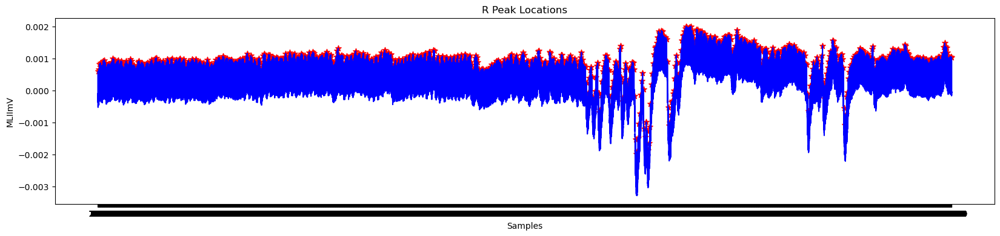

In [13]:
# Calculate the heart rate
heartRate = (60*fs)/np.average(rri)
print("Heart Rate",heartRate, "BPM")

# Plotting the R peak locations in ECG signal
plt.figure(figsize = (20,4), dpi = 100)
plt.xticks(np.arange(0, len(signal)+1, 150))
plt.plot(signal, color = 'blue')        
plt.scatter(result, signal[result], color = 'red', s = 50, marker= '*')
plt.xlabel('Samples')
plt.ylabel('MLIImV')
plt.title("R Peak Locations")

In [14]:
############################### Segment Grouping if we remove the very first R-Peak ###############################
#Segment in Samples
seg1 = trg1 - trg0 - r_peak[0]
seg2 = trg2 - trg0 - r_peak[0]
seg3 = trg3 - trg0 - r_peak[0]

#Segment in ms
newseg1 = int(seg1/fs)
newseg2 = int(seg2/fs)
newseg3 = int(seg3/fs)

exp_duration = (len(mne_ecg) - r_peak[0] - (len(mne_ecg) - r_peak[-1]))/fs  #Tot duration - First Peak - (Tot Duration - Last peak) 
############################### Segment Grouping if we remove the very first R-Peak ###############################

#### Data Interpolation and STFT

Text(0.5, 0, 'Time [sec]')

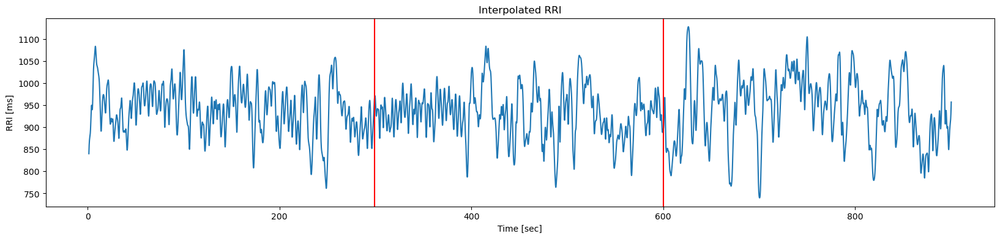

In [15]:
# #Data Interpolation, Fs = 1000
# exp_duration = len(mne_ecg)/fs

x_vals = np.linspace(r_peak[1],r_peak[-1],int(exp_duration*fs))
splines = scipy.interpolate.splrep(r_peak[1:],rri)
y_vals = scipy.interpolate.splev(x_vals,splines)

plt.figure(figsize = (20,4),dpi = 100)
plt.plot(x_vals/fs,y_vals)
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')

plt.title('Interpolated RRI')
plt.ylabel('RRI [ms]')
plt.xlabel('Time [sec]')

In [16]:
y_firstrest = y_vals[:seg1] 
y_stress = y_vals[seg1:seg2]
y_secondrest = y_vals[seg2:]

#### Time Analysis

In [17]:
#Measure SDNN
sdnn_full = np.std(y_vals)
sdnn_rest_1 = np.std(y_firstrest)
sdnn_test = np.std(y_stress)
sdnn_rest_2 = np.std(y_secondrest)
print("Standard Deviation during Experiment: ", sdnn_full)
print("Standard Deviation during First Rest: ", sdnn_rest_1)
print("Standard Deviation during CSWT: ", sdnn_test)
print("Standard Deviation during Second Rest: ", sdnn_rest_2)

Standard Deviation during Experiment:  62.618666942373174
Standard Deviation during First Rest:  53.64844171821438
Standard Deviation during CSWT:  55.08269363625606
Standard Deviation during Second Rest:  76.10188267692351


#### Frequency Analysis

##### PSD Measurement using Welch Method

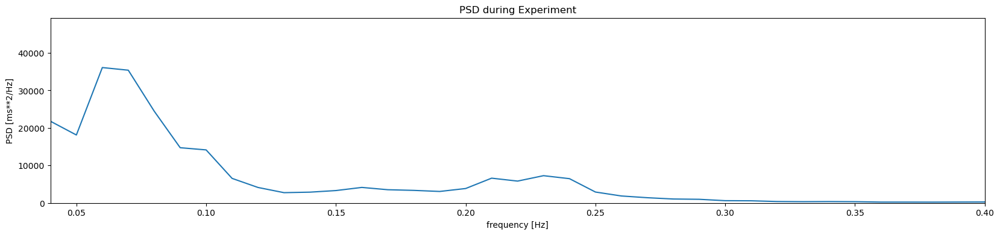

Absolute Power LF =  184335.41335373317 ms**2/Hz
Absolute Power HF =  59559.709218358796 ms**2/Hz
Total Power =  357840.3059807996 ms**2/Hz
LF/HF Ratio =  3.0949683229298453
Normalized Power LF =  51.51331760923096 %
Normalized Power HF =  16.64421481395518 %


In [18]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_vals,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Experiment')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

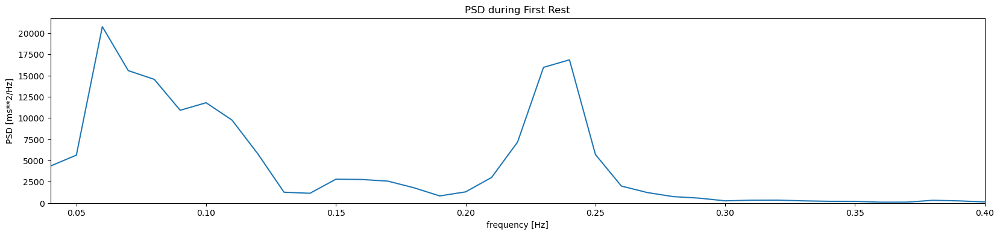

Absolute Power LF =  104277.06628794063 ms**2/Hz
Absolute Power HF =  67733.88682224082 ms**2/Hz
Total Power =  220036.65882106576 ms**2/Hz
LF/HF Ratio =  1.5395110362055975
Normalized Power LF =  47.39076972293918 %
Normalized Power HF =  30.783000971361847 %


In [19]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_firstrest,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during First Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

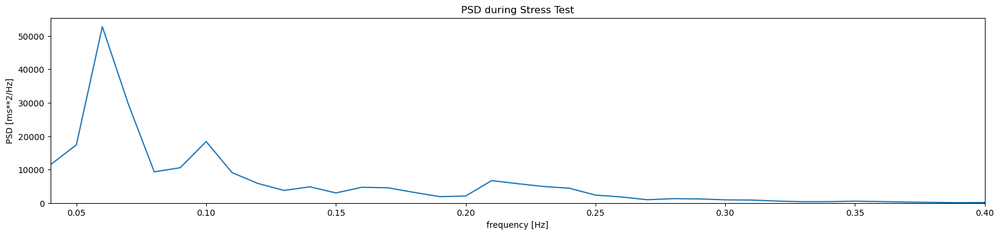

Absolute Power LF =  176014.62925761042 ms**2/Hz
Absolute Power HF =  53671.88414236118 ms**2/Hz
Total Power =  352790.935333336 ms**2/Hz
LF/HF Ratio =  3.279456871511033
Normalized Power LF =  49.892049831524794 %
Normalized Power HF =  15.213509976283568 %


In [20]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_stress,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Stress Test')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')


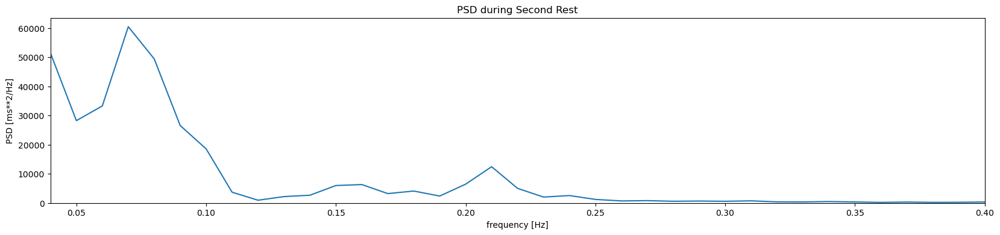

Absolute Power LF =  283448.1563010124 ms**2/Hz
Absolute Power HF =  58656.0802361212 ms**2/Hz
Total Power =  480468.6192171698 ms**2/Hz
LF/HF Ratio =  4.832374668746808
Normalized Power LF =  58.99410387359658 %
Normalized Power HF =  12.20809807135581 %


In [21]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_secondrest,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Second Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')


#### Time-Frequency Analysis

##### PSD Welch Over-time

In [22]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

# Calculate LF/HF ratio over time
lfhf_ratio = []
hf_over_time = []
lf_over_time = []

for i in range(0, len(y_vals), segment_length - overlap):
    segment = y_vals[i:i + segment_length]

    # Compute PSD using Welch's method
    f_den, Pxx_den = sg.welch(segment, fs=fs, nperseg = 10000)

    idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
    idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))

    # Calculate LF and HF power
    abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
    abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
    lf_hf_ratio = abs_power_LF / abs_power_HF

    # Calculate LF/HF ratio
    if math.isnan(lf_hf_ratio) == False:
        lfhf_ratio.append(lf_hf_ratio)
    if math.isnan(abs_power_HF) == False:
        hf_over_time.append(abs_power_HF)
    if math.isnan(abs_power_LF) == False:
        lf_over_time.append(abs_power_LF)

c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 9012, using nperseg = 9012
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 8012, using nperseg = 8012
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 7012, using nperseg = 7012
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 6012, using nperseg = 6012
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-p

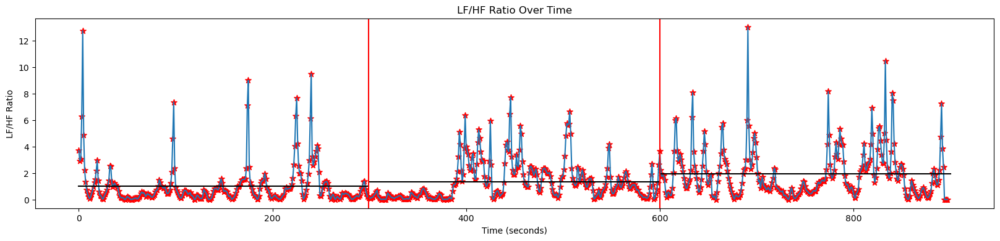

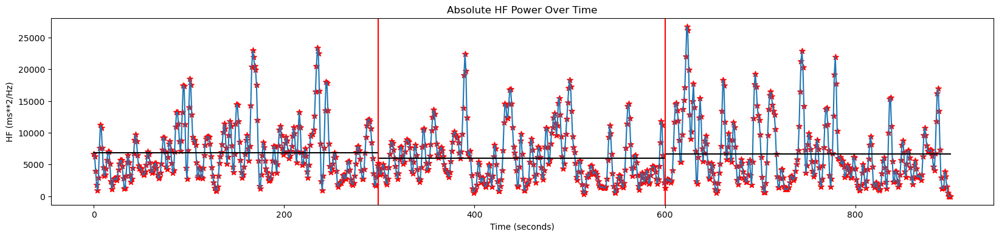

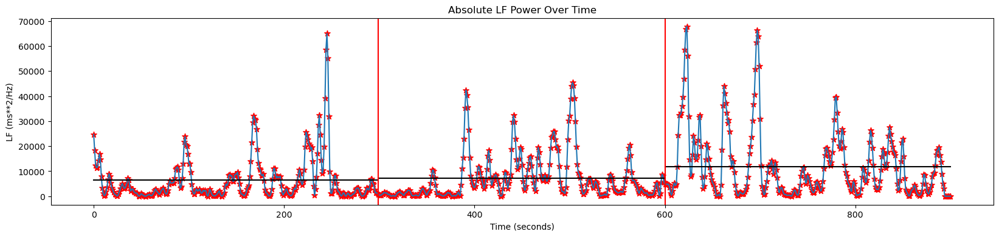

In [23]:
# Plot LF/HF ratio over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio)
plt.plot((0, newseg1), (np.average(lfhf_ratio[0:newseg1]),np.average(lfhf_ratio[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lfhf_ratio[newseg1:newseg2]),np.average(lfhf_ratio[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lfhf_ratio[newseg2:]),np.average(lfhf_ratio[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio, color = 'red', s = 50, marker= '*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF/HF Ratio')
plt.title('LF/HF Ratio Over Time')
plt.show()

# Plot HF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time)
plt.plot((0, newseg1), (np.average(hf_over_time[0:newseg1]),np.average(hf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(hf_over_time[newseg1:newseg2]),np.average(hf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(hf_over_time[newseg2:]),np.average(hf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('HF (ms**2/Hz)')
plt.title('Absolute HF Power Over Time')
plt.show()

# Plot LF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time)
plt.plot((0, newseg1), (np.average(lf_over_time[0:newseg1]),np.average(lf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lf_over_time[newseg1:newseg2]),np.average(lf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lf_over_time[newseg2:]),np.average(lf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF (ms**2/Hz)')
plt.title('Absolute LF Power Over Time')
plt.show()

##### STFT

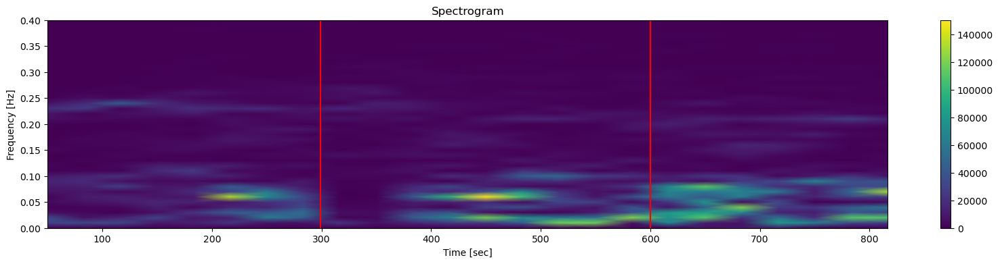

In [24]:
#STFT RRI
nperseg = 100000
noverlap = nperseg*2/3
f1,t1,Sxx = scipy.signal.spectrogram(y_vals, fs=fs, nperseg = nperseg, noverlap = noverlap, scaling='density')
plt.figure(figsize = (20,4), dpi = 100)
plt.pcolormesh(t1, f1, np.abs(Sxx), shading='gouraud', snap= True)
plt.title('Spectrogram')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.axis([t1[0], t1[-1], 0, 0.4])
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.colorbar()
plt.show()

## EEG Analysis

In [6]:
#raw_eeg = raw.copy().crop(tmin = 39.471, tmax = 939.971).pick_types(eeg=True, eog=False, ecg=False) #make a copy
# raw_temp_short = raw.copy().crop(tmin=339.471, tmax = 519.471)

raw_temp = raw.copy().crop(tmin = tmin, tmax = tmax) #make a copy

# eeg_firstrest = raw.copy().crop(tmin = 39.471, tmax = 339.471)
# eeg_stress = raw.copy().crop(tmin = 339.471, tmax = 639.471)
# eeg_secondrest = raw.copy().crop(tmin = 639.471, tmax = 939.971)

In [7]:
############################### Segment Grouping for EEG ###############################
#Segment in Samples
eeg_seg1 = trg1 - trg0
eeg_seg2 = trg2 - trg0
eeg_seg3 = trg3 - trg0

#Segment in ms
eeg_newseg1 = int(eeg_seg1/fs)
eeg_newseg2 = int(eeg_seg2/fs)
eeg_newseg3 = int(eeg_seg3/fs)
############################### Segment Grouping for EEG ###############################

### Using Concatenated EEG

In [6]:
raw_temp = raw.copy().crop(tmax = 2.800)
raw_con2 = raw.copy().crop(tmin = 42.271, tmax = 939.971)
mne.io.concatenate_raws(
    [raw_temp, raw_con2], on_mismatch="ignore"
)

### ICA 

In [8]:
#Regular Expression = Search certain pattern
regexp = r"(ECG|vEOG|hEOG)"
artifact_picks = mne.pick_channels_regexp(raw_temp.ch_names, regexp=regexp)
# raw_temp.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

##### Visualizing Artifact

Using EOG channels: vEOG, hEOG
EOG channel index for this subject is: [64 65]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Now detecting blinks and generating corresponding events
Found 90 significant peaks
Number of EOG events detected: 90
Not setting metadata
90 matching events found
No baseline correction applied
Loading data for 90 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dat

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


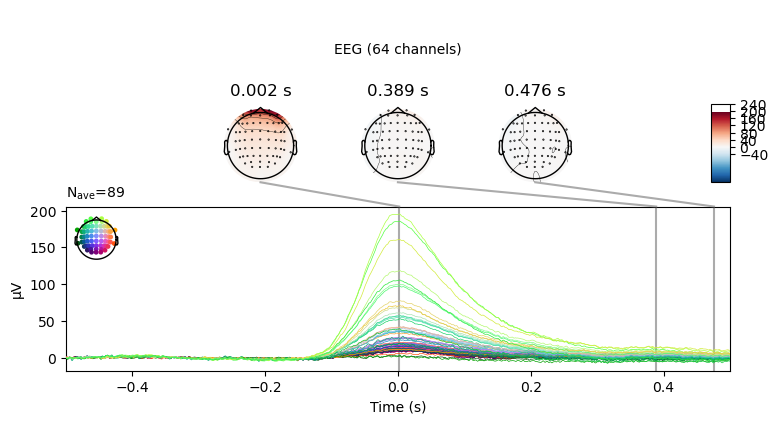

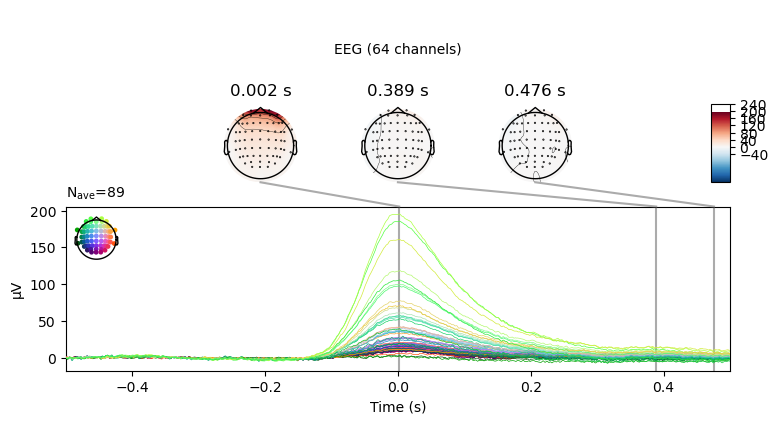

In [9]:
eog_evoked = create_eog_epochs(raw_temp).average()
eog_evoked.apply_baseline(baseline=(None, -0.2))
eog_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 938 (average pulse 62 / min.)
Not setting metadata
938 matching events found
No baseline correction applied
Loading data for 938 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dataset. Please consider the method self.add_proj.


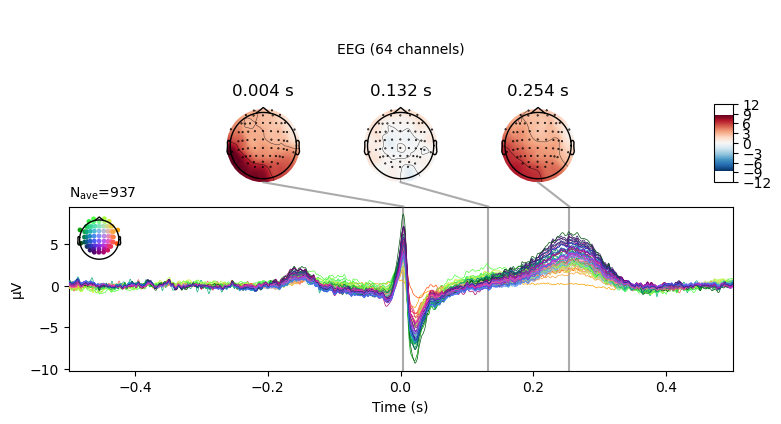

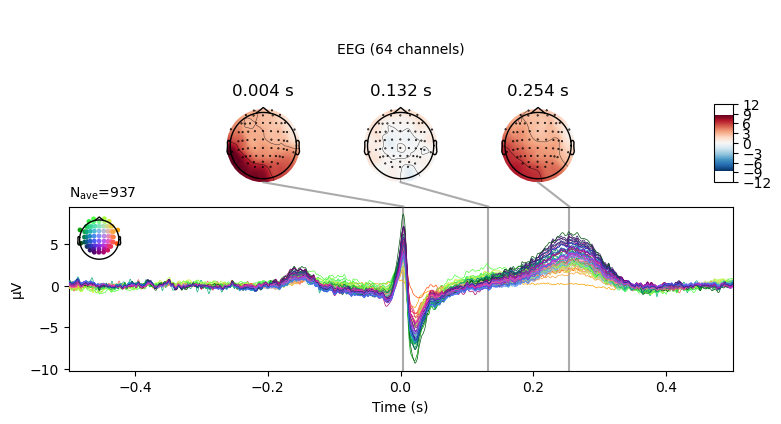

In [10]:
ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked.apply_baseline(baseline=(None, -0.2))
ecg_evoked.plot_joint()

##### Filtering to Remove Slow Drifts

In [11]:
filt_raw = raw_temp.load_data().copy().filter(l_freq=1.0, h_freq=None)

Reading 0 ... 900501  =      0.000 ...   900.501 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 3301 samples (3.301 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  64 out of  64 | elapsed:    1.5s finished


##### Extracting PCA

In [12]:
ica = ICA(n_components=32, max_iter="auto", random_state = 95)
ica.fit(filt_raw)
ica

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 32 components
Fitting ICA took 52.8s.


Method,fastica
Fit,32 iterations on raw data (900502 samples)
ICA components,32
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


Creating RawArray with float64 data, n_channels=35, n_times=900502
    Range : 39471 ... 939972 =     39.471 ...   939.972 secs
Ready.
Using qt as 2D backend.
You set the browser-backend to "qt" but your current version 0.0.0 of mne-qt-browser is too low for ICA.Update with pip or conda.Defaults to matplotlib.
Using matplotlib as 2D backend.


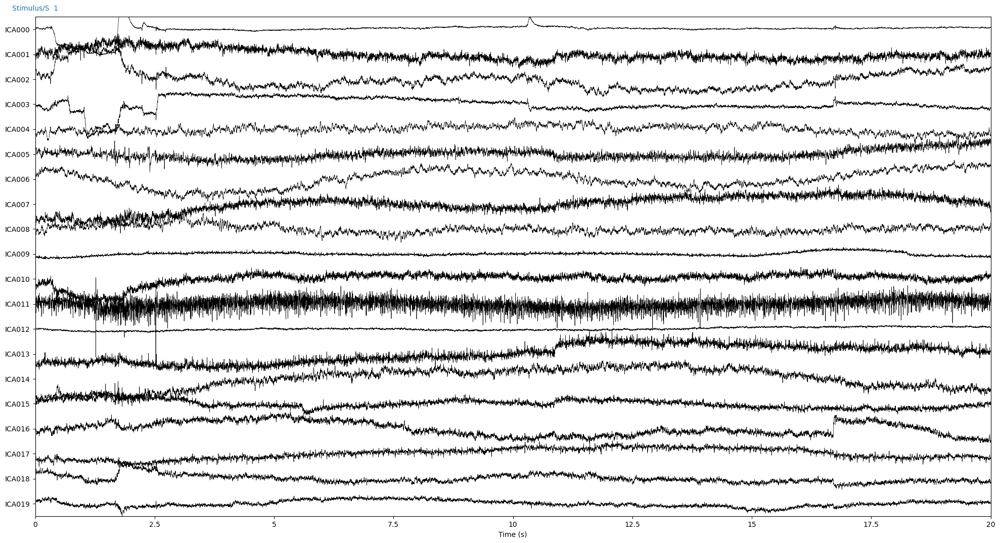

Using qt as 2D backend.


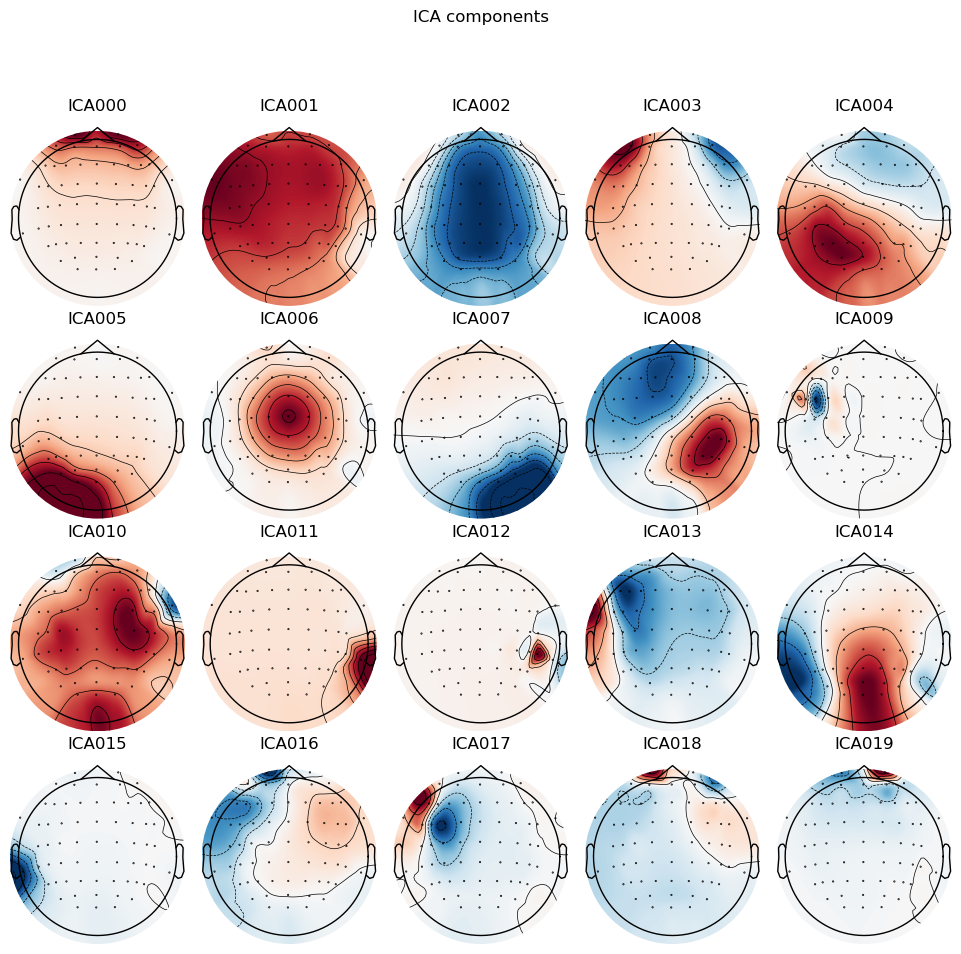

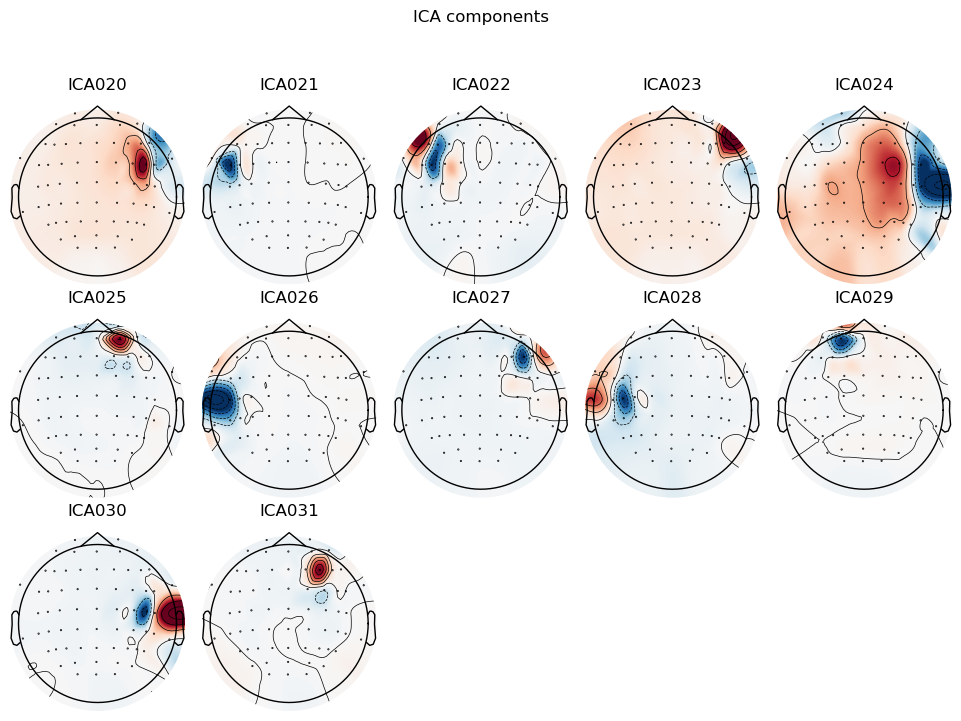

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x731.5 with 12 Axes>]

In [13]:
ica.plot_sources(raw_temp, show_scrollbars=False)
ica.plot_components()

##### Check Blinks PCA

Using EOG channels: vEOG, hEOG
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    1.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    1.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 2 ICA components
    Projecting back using 64 PCA components


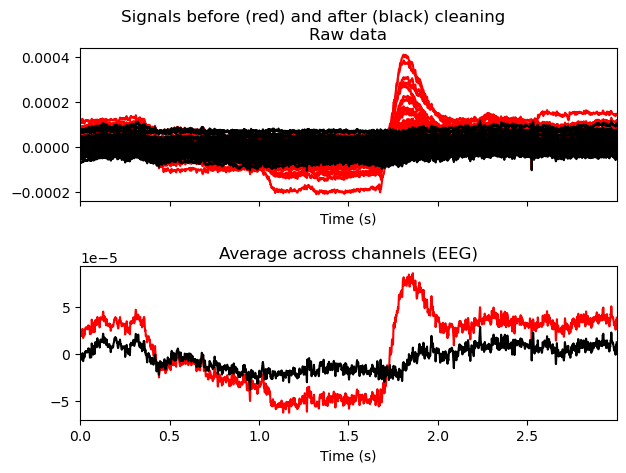

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
450 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
450 matching events found
No baseline correction applied
0 projection items activated


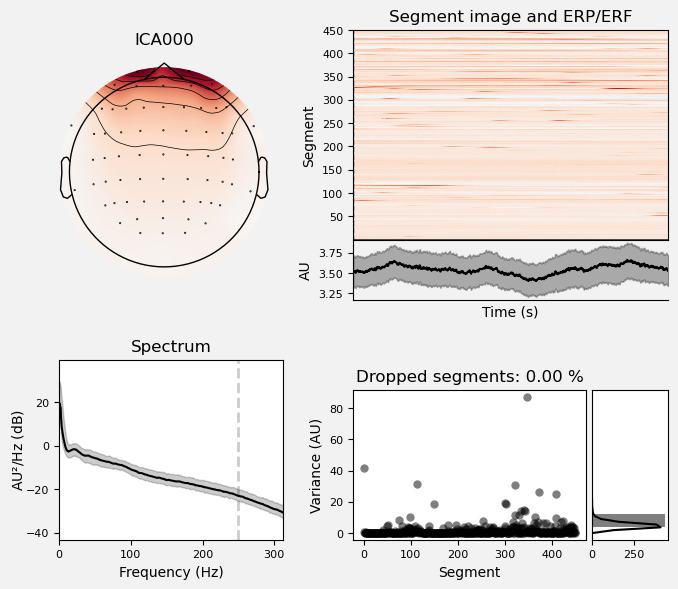

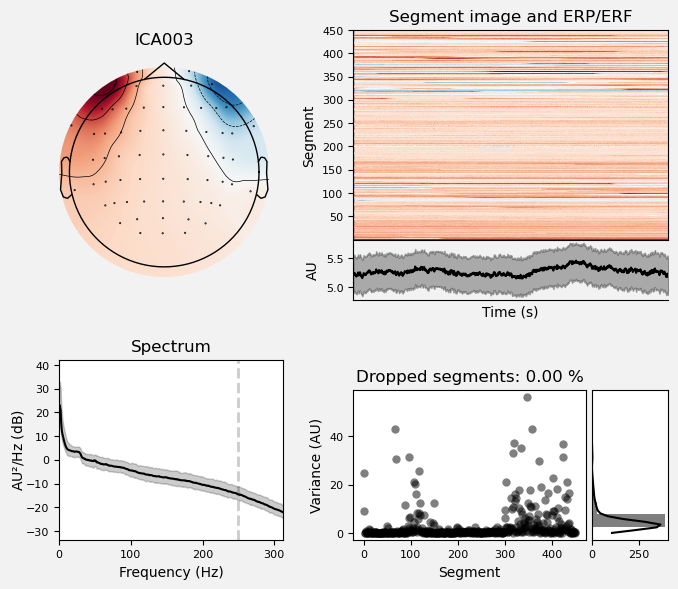

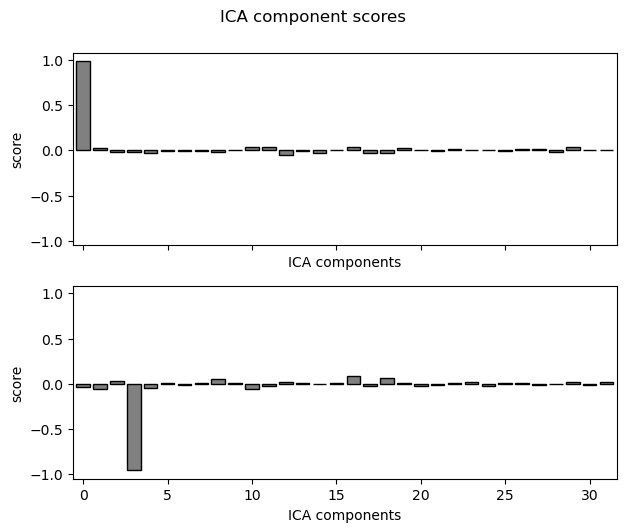

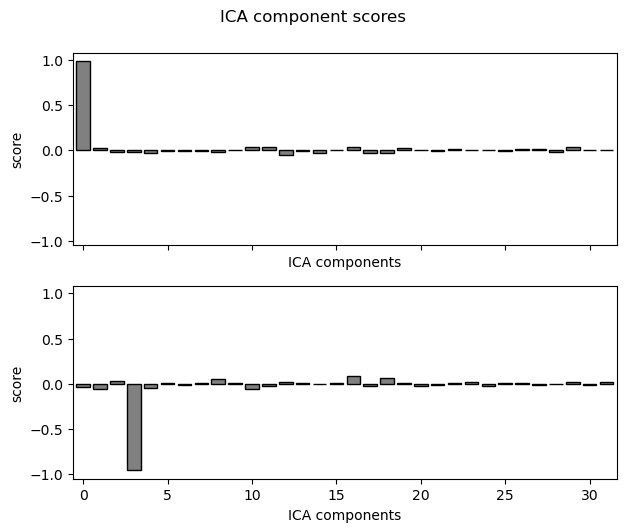

In [14]:
# Remove blinks PCA
eog_indices, eog_scores = ica.find_bads_eog(raw_temp, ch_name=['vEOG', 'hEOG'], threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=eog_indices, picks="eeg")
# ica.exclude = eog_indices

ica.plot_properties(raw_temp, picks=eog_indices)
ica.plot_scores(eog_scores)

##### Check ECG PCA

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 938 (average pulse 62 / min.)
Not setting metadata
938 matching events found
No baseline correction applied
Using data from preloaded Raw for 938 events and 1001 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 4 ICA components
    Projecting back using 64 PCA components


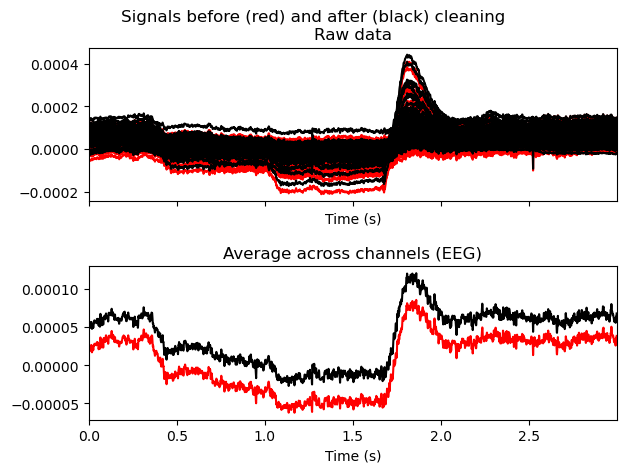

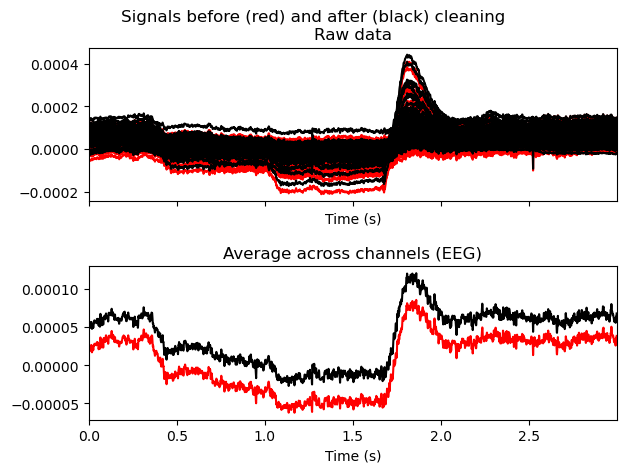

In [15]:
#Remove heart beat PCA
ecg_indices, ecg_scores = ica.find_bads_ecg(raw_temp, ch_name='ECG',threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=ecg_indices, picks="eeg")
# ica.exclude = ecg_indices

# ica.plot_properties(raw_temp, picks=ecg_indices)
# ica.plot_scores(ecg_scores)

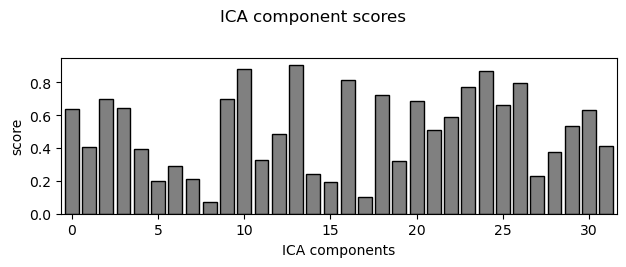

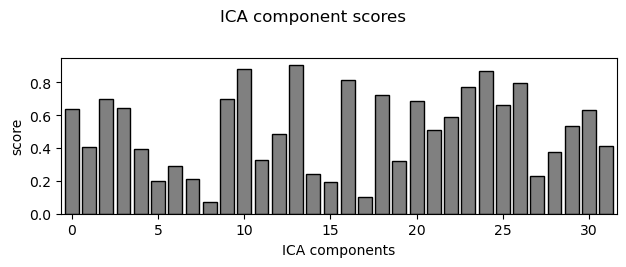

In [16]:
ica.plot_scores(ecg_scores)

##### Check Muscle PCA

Effective window size : 0.256 (s)


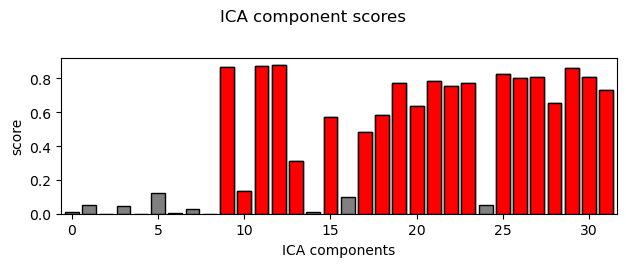

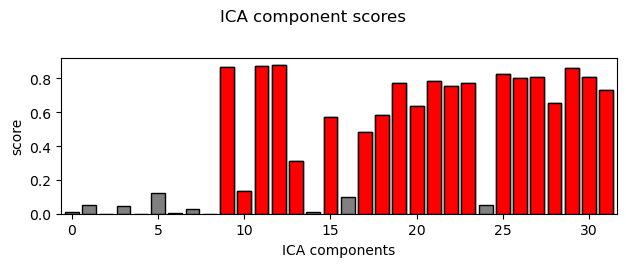

In [17]:
muscle_idx_auto, scores = ica.find_bads_muscle(raw)
ica.plot_scores(scores, exclude=muscle_idx_auto)

##### Apply ICA

In [18]:
# ica.exclude = [0, 3, 18, 19, 10, 11, 15,26,27, 29, 24, 30, 9, 23,31]
# ica.exclude = [0, 3, 17, 19, 15, 29, 30]
ica.exclude = eog_indices

In [19]:
# ica.apply() changes the Raw object in-place, so let's make a copy first:
reconst_raw = raw_temp.copy()
ica.apply(reconst_raw)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 2 ICA components
    Projecting back using 64 PCA components


<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 900502 (900.5 s), ~460.4 MB, data loaded>

### After ICA EEG Analysis

In [20]:
#Comparison between before and after ICA
reconst_raw.plot(title = 'Reconstructed')
raw_temp.plot(title = 'Raw')

In [21]:
#Split After ICA Data into each segments

ica_firstrest = reconst_raw.copy().crop(tmin = 0, tmax = eeg_newseg1)
ica_stress = reconst_raw.copy().crop(tmin = eeg_newseg1, tmax = eeg_newseg2)
ica_secondrest = reconst_raw.copy().crop(tmin = eeg_newseg2)

### Frequency Analysis

##### PSD Analysis on EEG

Effective window size : 0.256 (s)


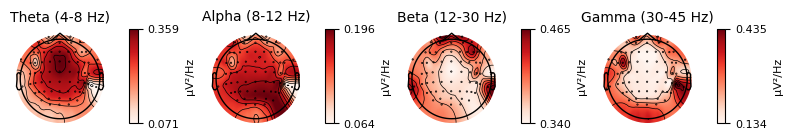

In [22]:
#### Full Experiment Plot
eeg_psd = reconst_raw.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


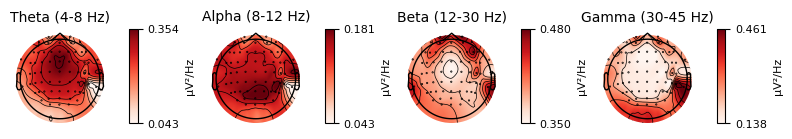

In [23]:
#### First Rest Plot
psd_firstrest = ica_firstrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


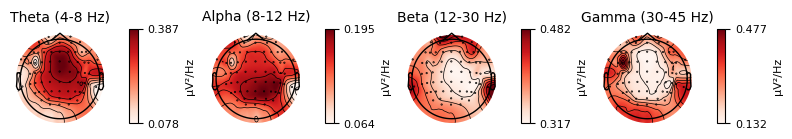

In [24]:
#### Stress Task Plot
psd_stress = ica_stress.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


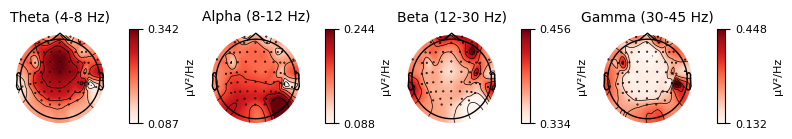

In [25]:
#### Second Rest Plot
psd_secondrest = ica_secondrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

### Time-Frequency Analysis

In [26]:
raw_eeg = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
eeg_ch_names = raw_eeg.ch_names
eeg_data, _ = raw_eeg.get_data(picks = ['eeg'], return_times=True)

In [27]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

#### PSD Overtime Theta Band [4 - 8 Hz]

c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 9502, using nperseg = 9502
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 8502, using nperseg = 8502
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 7502, using nperseg = 7502
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 6502, using nperseg = 6502
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\s

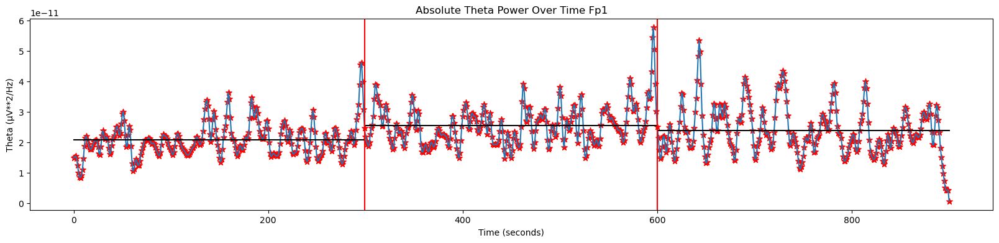

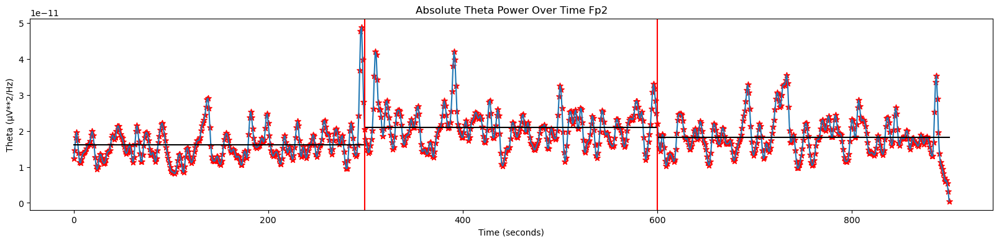

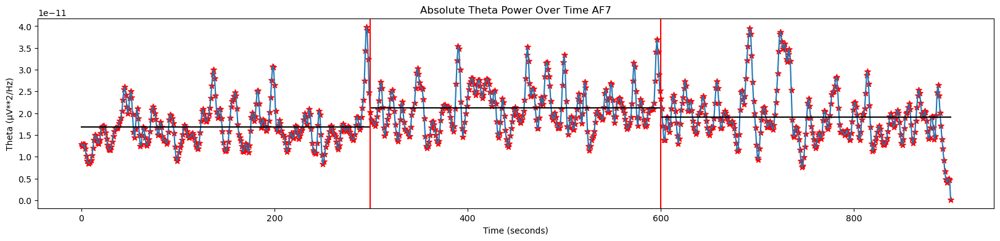

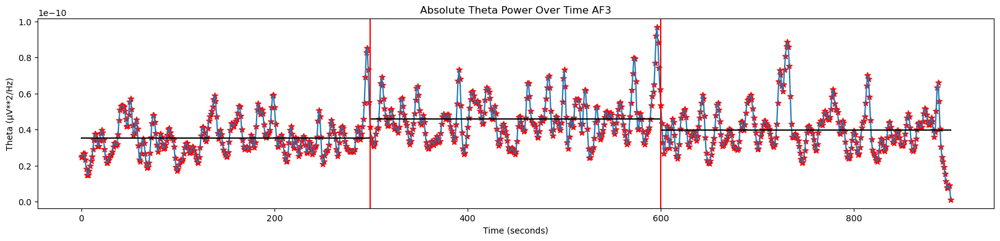

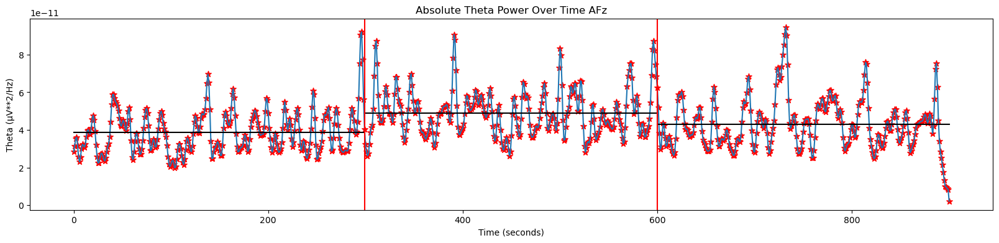

...

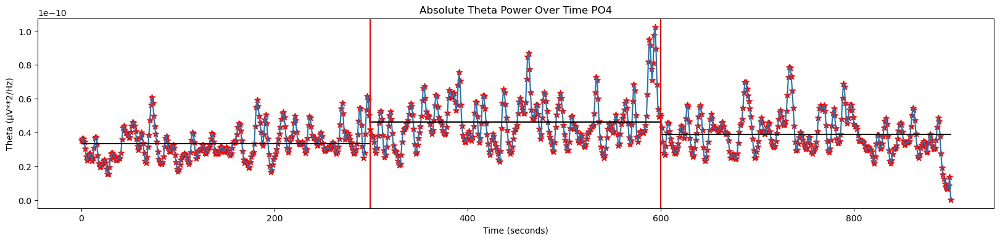

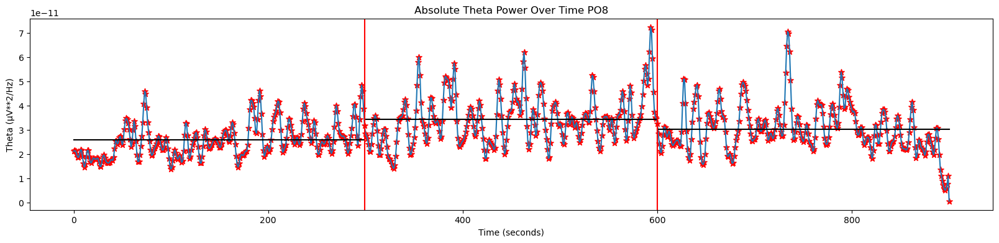

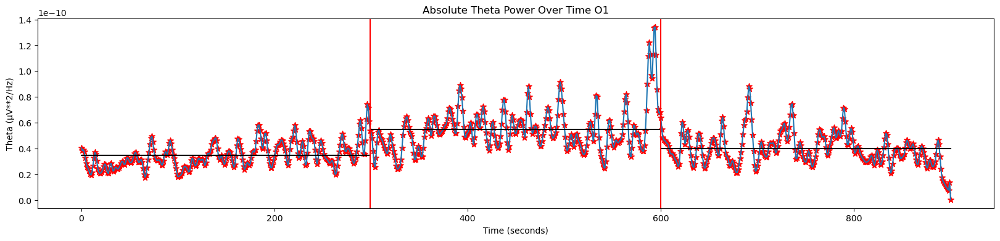

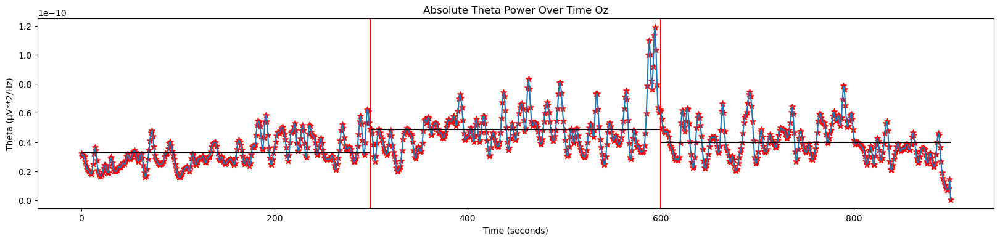

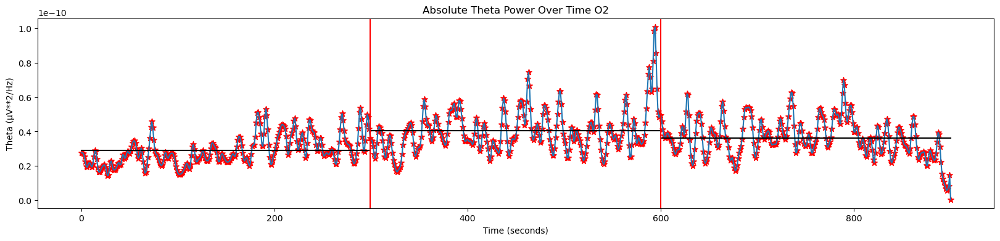

In [28]:
# Calculate Theta Band over time
theta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    theta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_theta = np.where((4 <= f_eeg) & (f_eeg <= 8))

        # Calculate Absolute Theta power
        abs_power_theta = np.sum(np.abs(Pxx_eeg[idx_theta]))

        # Append data
        if math.isnan(abs_power_theta) == False:
            theta_over_time.append(abs_power_theta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(theta_over_time[0:eeg_newseg1]),np.average(theta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(theta_over_time[eeg_newseg1:eeg_newseg2]),np.average(theta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(theta_over_time[eeg_newseg2:]),np.average(theta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Theta (μV**2/Hz)')
    plt.title('Absolute Theta Power Over Time '+ ch_name)
    plt.show()

    theta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : theta_over_time[0:eeg_newseg1],
        "power stress" : theta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : theta_over_time[eeg_newseg2:eeg_newseg3]
    }
    theta_data.append(theta_row_data)

#### PSD Overtime Alpha Band [8 - 12 Hz]

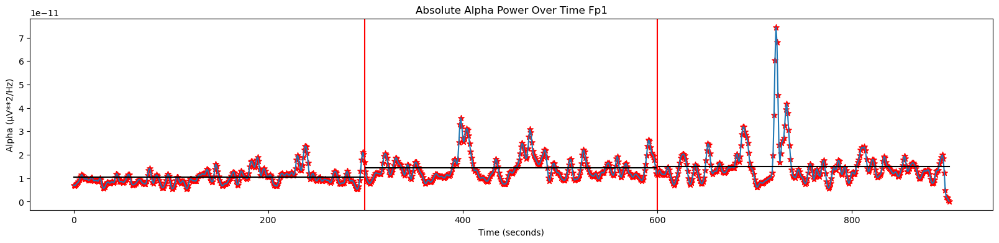

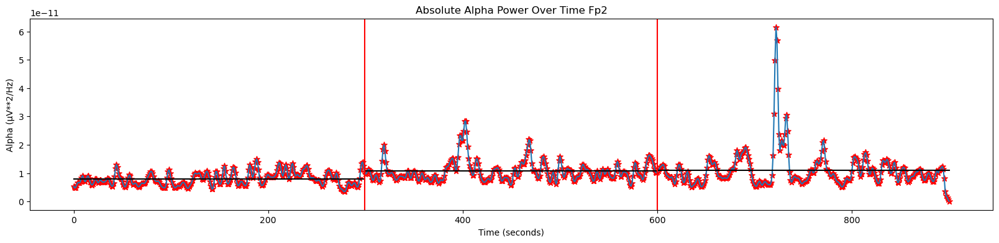

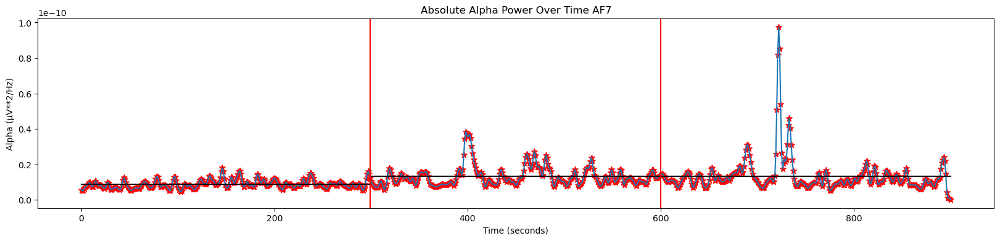

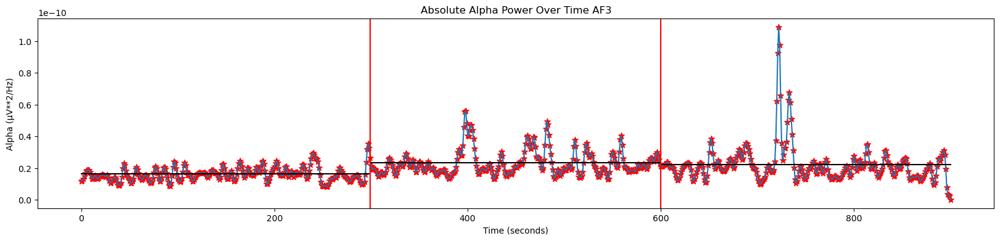

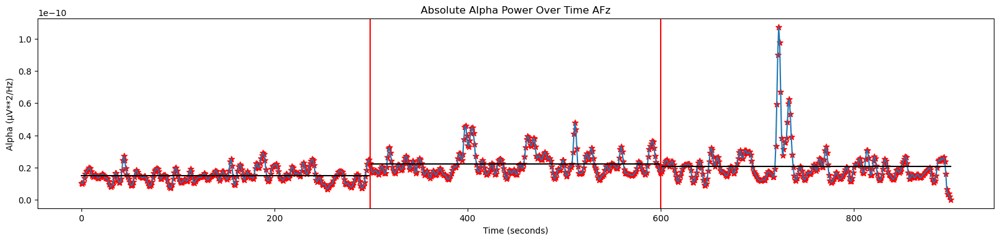

...

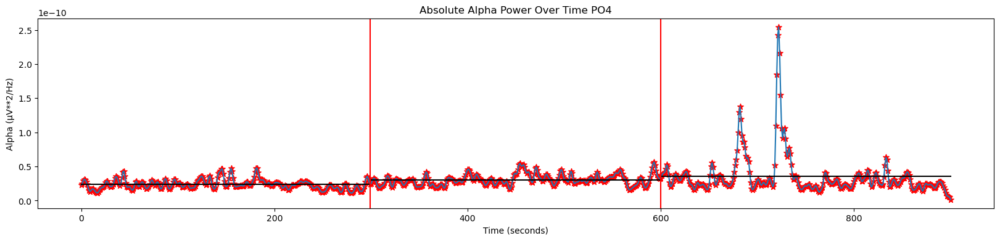

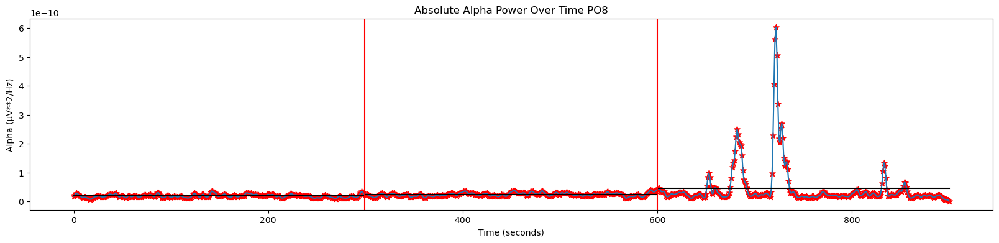

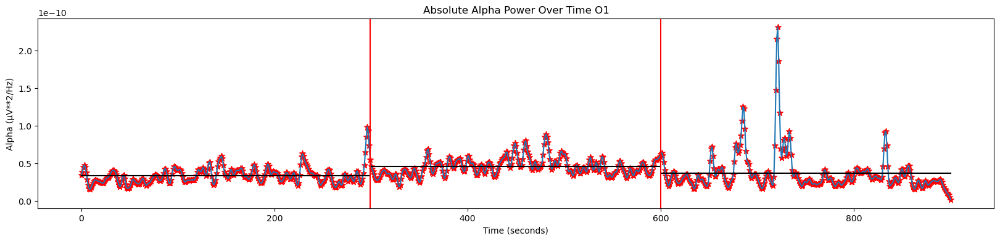

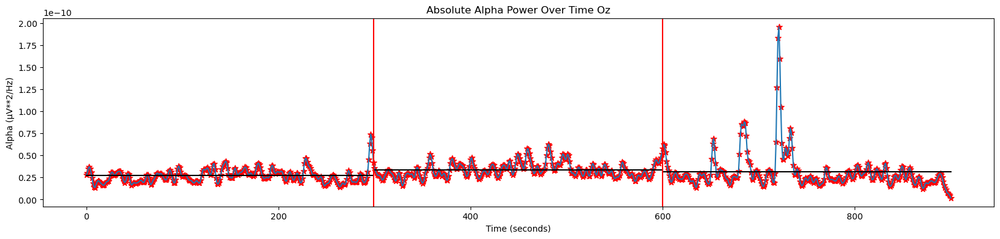

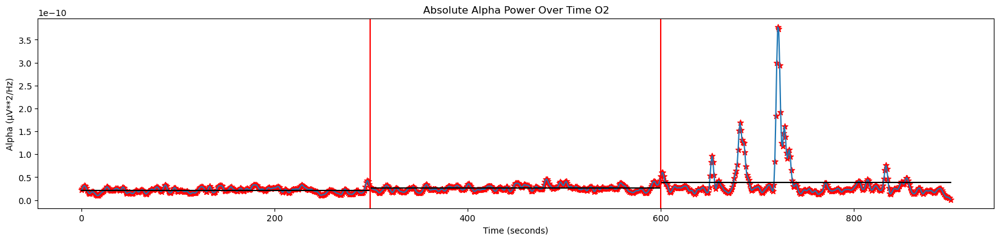

In [29]:
# Calculate Alpha Band over time
alpha_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    alpha_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_alpha = np.where((8 <= f_eeg) & (f_eeg <= 12))

        # Calculate Absolute Alpha power
        abs_power_alpha = np.sum(np.abs(Pxx_eeg[idx_alpha]))

        # Append data
        if math.isnan(abs_power_alpha) == False:
            alpha_over_time.append(abs_power_alpha)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time)
    plt.plot((0, eeg_newseg1), (np.average(alpha_over_time[0:eeg_newseg1]),np.average(alpha_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(alpha_over_time[eeg_newseg1:eeg_newseg2]),np.average(alpha_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(alpha_over_time[eeg_newseg2:]),np.average(alpha_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Alpha (μV**2/Hz)')
    plt.title('Absolute Alpha Power Over Time '+ ch_name)
    plt.show()
    
    alpha_row_data = {
        "ch_name": ch_name, 
        "power first rest" : alpha_over_time[0:eeg_newseg1],
        "power stress" : alpha_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : alpha_over_time[eeg_newseg2:eeg_newseg3]
    }
    alpha_data.append(alpha_row_data)

#### PSD Overtime Beta Band [12 - 30 Hz]

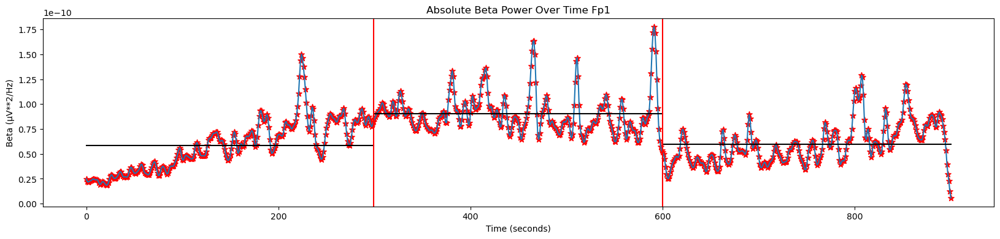

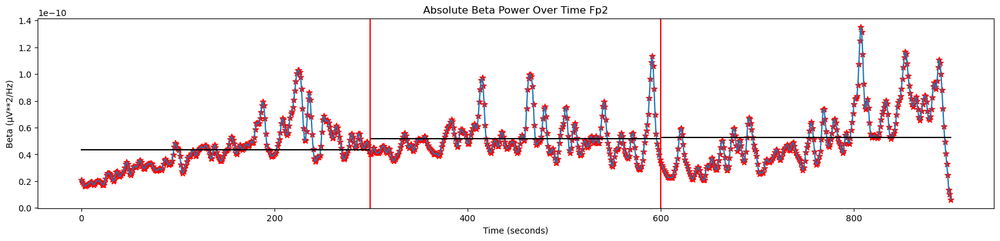

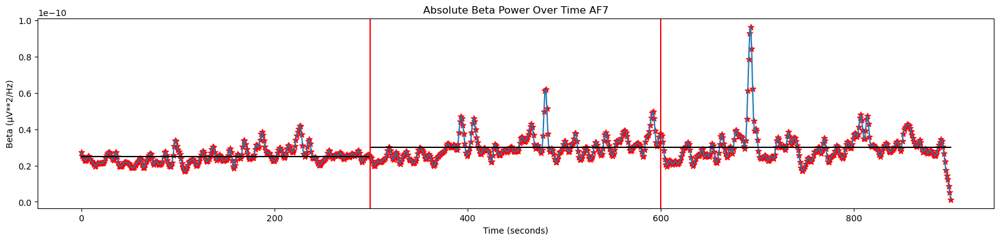

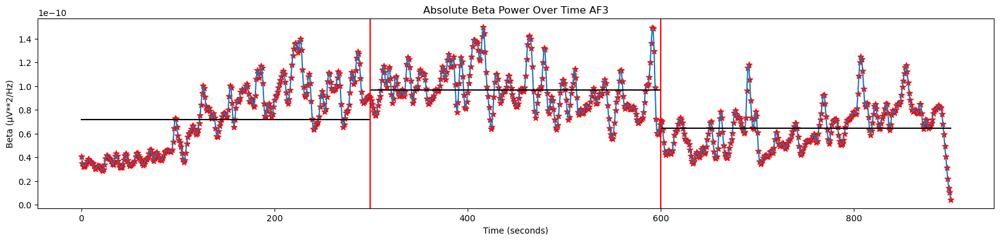

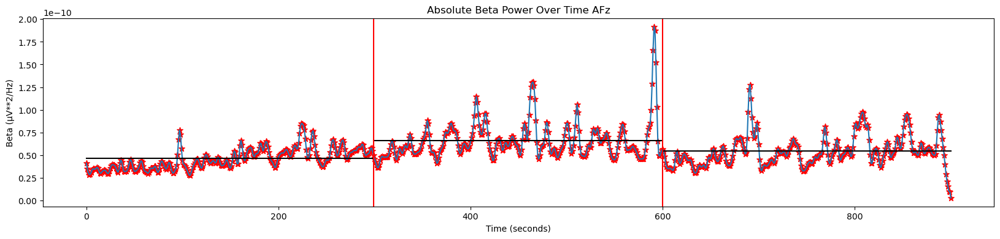

...

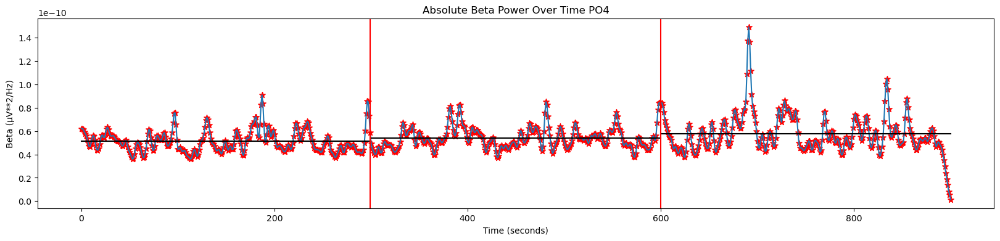

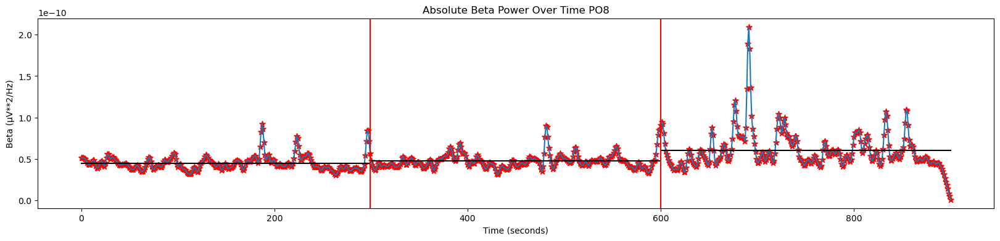

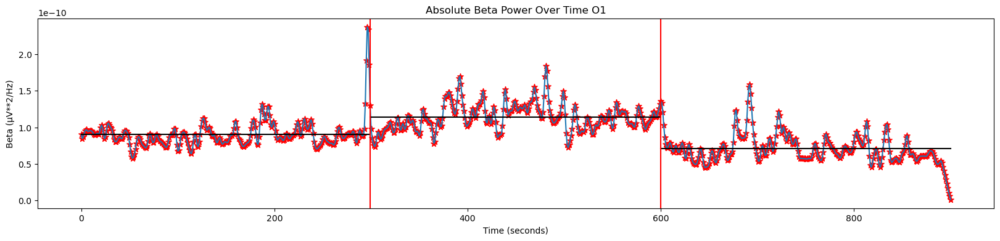

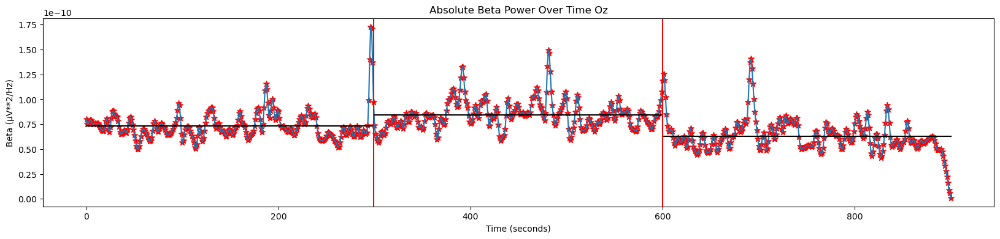

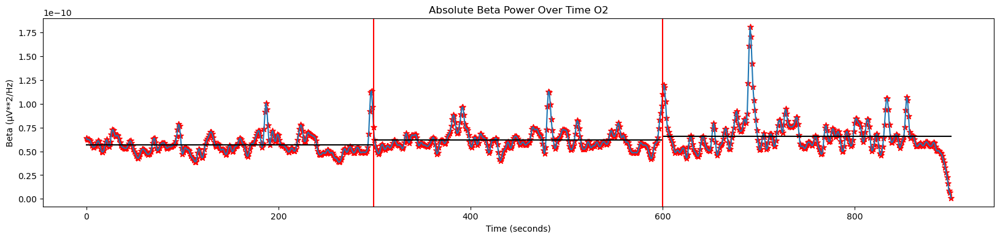

In [31]:
# Calculate Beta Band over time
beta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    beta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_beta = np.where((12 <= f_eeg) & (f_eeg <= 30))

        # Calculate Absolute Beta power
        abs_power_beta = np.sum(np.abs(Pxx_eeg[idx_beta]))

        # Append data
        if math.isnan(abs_power_beta) == False:
            beta_over_time.append(abs_power_beta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(beta_over_time[0:eeg_newseg1]),np.average(beta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(beta_over_time[eeg_newseg1:eeg_newseg2]),np.average(beta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(beta_over_time[eeg_newseg2:]),np.average(beta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Beta (μV**2/Hz)')
    plt.title('Absolute Beta Power Over Time '+ ch_name)
    plt.show()

    beta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : beta_over_time[0:eeg_newseg1],
        "power stress" : beta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : beta_over_time[eeg_newseg2:eeg_newseg3]
    }
    beta_data.append(beta_row_data)

#### PSD Overtime Gamma Band [30 - 45 Hz]

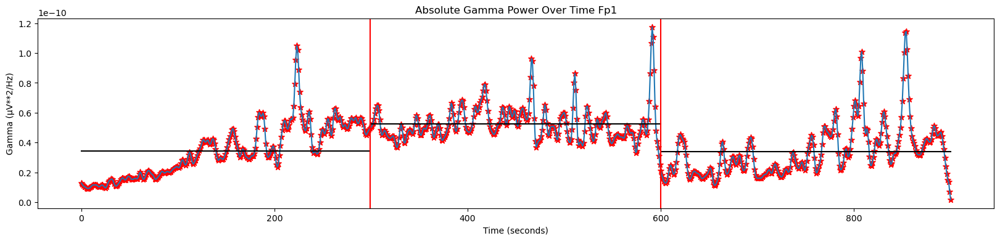

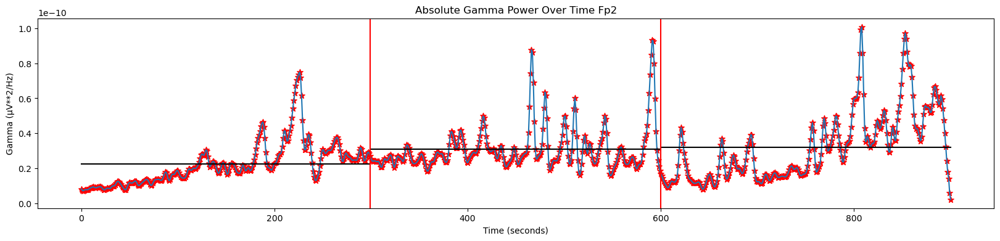

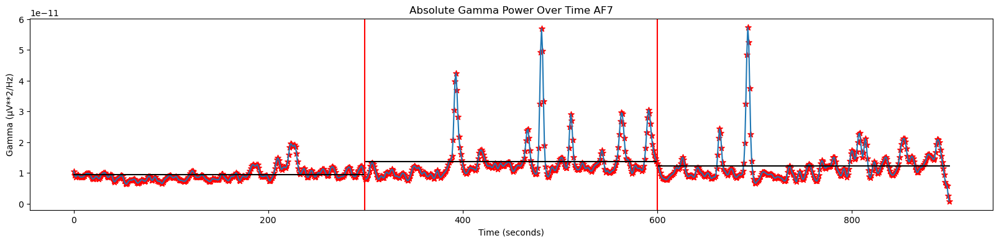

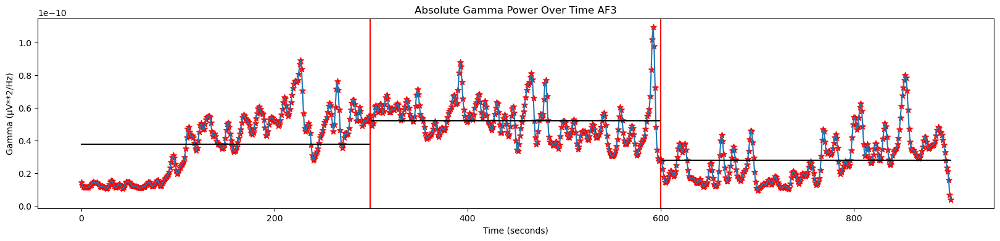

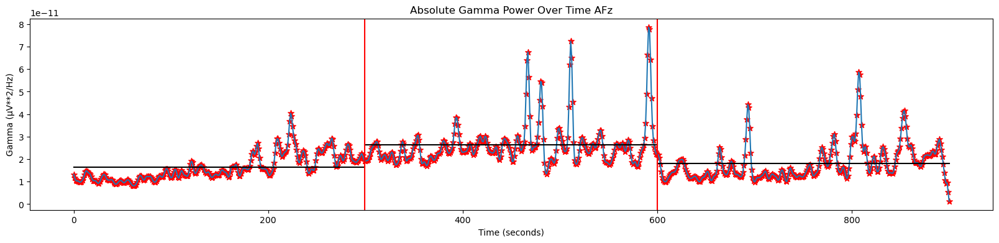

...

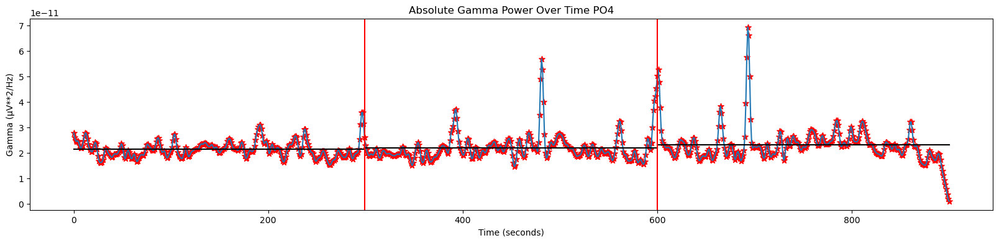

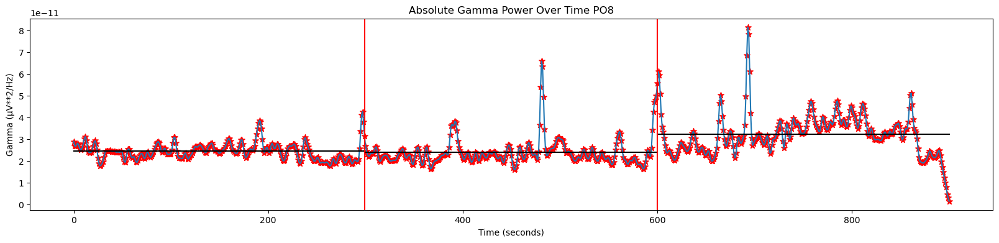

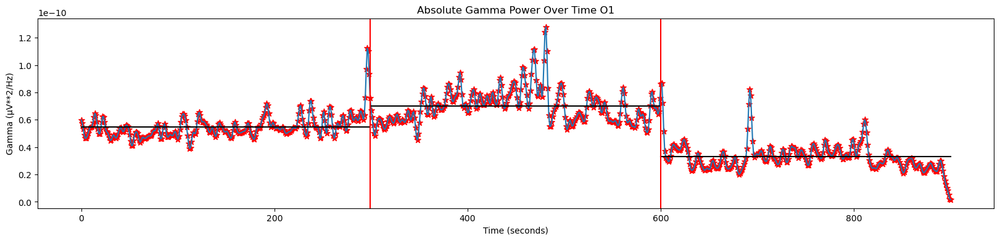

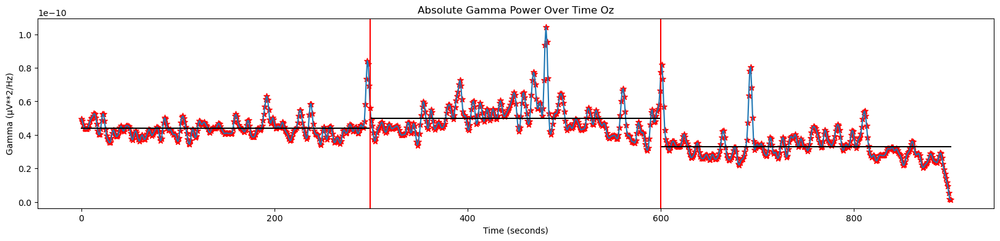

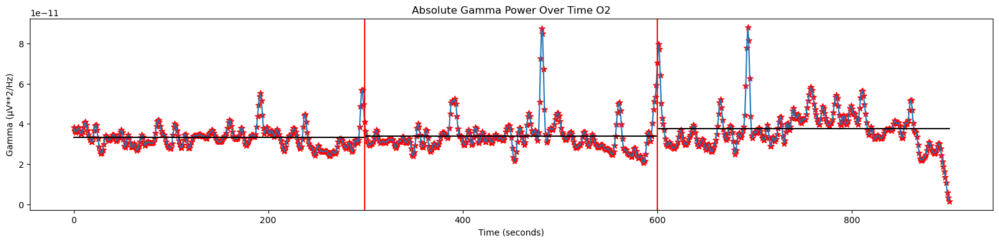

In [32]:
# Calculate Gamma Band over time
gamma_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    gamma_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_gamma = np.where((30 <= f_eeg) & (f_eeg <= 45))

        # Calculate Absolute Gamma power
        abs_power_gamma = np.sum(np.abs(Pxx_eeg[idx_gamma]))

        # Append data
        if math.isnan(abs_power_gamma) == False:
            gamma_over_time.append(abs_power_gamma)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time)
    plt.plot((0, eeg_newseg1), (np.average(gamma_over_time[0:eeg_newseg1]),np.average(gamma_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(gamma_over_time[eeg_newseg1:eeg_newseg2]),np.average(gamma_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(gamma_over_time[eeg_newseg2:]),np.average(gamma_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Gamma (μV**2/Hz)')
    plt.title('Absolute Gamma Power Over Time '+ ch_name)
    plt.show()

    gamma_row_data = {
        "ch_name": ch_name, 
        "power first rest" : gamma_over_time[0:eeg_newseg1],
        "power stress" : gamma_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : gamma_over_time[eeg_newseg2:eeg_newseg3]
    }
    gamma_data.append(gamma_row_data)

#### PSD Data to Data Frame and Array

In [33]:
theta_df = pd.DataFrame(theta_data)
display(theta_df)
# theta_array = np.array(theta_data)
# theta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
theta_array = theta_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[1.492293051471341e-11, 1.5155749646043013e-11...","[2.4741413359276672e-11, 2.1877338057720144e-1...","[2.5190291592839775e-11, 2.1515769611462718e-1..."
1,Fp2,"[1.239726569439594e-11, 1.4595102897080243e-11...","[2.0468198860476214e-11, 1.767433613885174e-11...","[2.2020317799994366e-11, 1.877019085260445e-11..."
2,AF7,"[1.2923358674306622e-11, 1.2434358972379682e-1...","[2.022232647853231e-11, 1.856343258089283e-11,...","[2.338110210679004e-11, 2.1017895155777127e-11..."
3,AF3,"[2.4824742763219943e-11, 2.521765495793091e-11...","[4.1437170388857486e-11, 3.537289821771817e-11...","[5.328890920978698e-11, 4.355132708252826e-11,..."
4,AFz,"[2.843049209639804e-11, 3.139732008567504e-11,...","[4.0420350514637316e-11, 3.23449440260871e-11,...","[6.235712312607977e-11, 5.18001510992552e-11, ..."
...,...,...,...,...
59,PO4,"[3.530126850842081e-11, 3.6351641733815205e-11...","[4.170282915757515e-11, 3.81107457999599e-11, ...","[4.9734236201868894e-11, 4.303245605187764e-11..."
60,PO8,"[2.118371743524855e-11, 2.1420313976804136e-11...","[3.1844263967536285e-11, 2.8510507900030877e-1...","[3.249467694615684e-11, 2.848631627569608e-11,..."
61,O1,"[4.046459889552964e-11, 3.847910043346483e-11,...","[5.3887662502221806e-11, 5.213219293747189e-11...","[6.369453006290102e-11, 5.489154622653583e-11,..."
62,Oz,"[3.2012766042237446e-11, 3.069408172921793e-11...","[4.9160617407930894e-11, 4.883010128409955e-11...","[6.130834493700389e-11, 5.582458790149175e-11,..."


In [34]:
alpha_df = pd.DataFrame(alpha_data)
display(alpha_df)
# alpha_array = np.array(alpha_data)
# beta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
alpha_array = alpha_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[7.034574313596842e-12, 6.783023556417777e-12,...","[1.6764610317733164e-11, 1.276472736726711e-11...","[1.1399505642695236e-11, 1.2383653437220682e-1..."
1,Fp2,"[5.309169928004405e-12, 4.773783970027059e-12,...","[1.0629397861022217e-11, 9.674413156857659e-12...","[1.0294242604073925e-11, 1.074578410124045e-11..."
2,AF7,"[5.773506849315847e-12, 5.120768025593383e-12,...","[1.2382614315138015e-11, 1.0400736362732183e-1...","[1.4145387647675164e-11, 1.4538292915049463e-1..."
3,AF3,"[1.1663298297956018e-11, 1.2020446701282562e-1...","[2.6611518456876438e-11, 2.1461695054533994e-1...","[2.1108577117112927e-11, 2.081296272859225e-11..."
4,AFz,"[1.0327815266474223e-11, 9.875336169069723e-12...","[2.2781428176251782e-11, 1.9628922592591214e-1...","[1.645703829336256e-11, 1.755798394896151e-11,..."
...,...,...,...,...
59,PO4,"[2.2852863251481946e-11, 2.4896541101104247e-1...","[2.4108787559078964e-11, 2.5023725433053685e-1...","[3.279075139481988e-11, 3.6396416068422723e-11..."
60,PO8,"[1.8323747445859235e-11, 2.1823196220564468e-1...","[2.3771311484691798e-11, 2.420781281589242e-11...","[4.180041099288195e-11, 4.53778642386451e-11, ..."
61,O1,"[3.4346283146929503e-11, 3.852218074620521e-11...","[5.5129892345612355e-11, 4.59792741023209e-11,...","[6.231056046310614e-11, 6.409906372891678e-11,..."
62,Oz,"[2.7884937133631656e-11, 3.012893769645455e-11...","[4.2010378271438437e-11, 3.541706262724378e-11...","[5.7648930742294296e-11, 6.236106351540157e-11..."


In [35]:
beta_df = pd.DataFrame(beta_data)
display(beta_df)
# beta_array = np.array(beta_data)
# beta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
beta_array = beta_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[2.494911992232275e-11, 2.227683625127877e-11,...","[8.265767056058179e-11, 8.525328440864975e-11,...","[5.178788913839142e-11, 4.9716318173489654e-11..."
1,Fp2,"[2.1027643877621683e-11, 1.9524704083361875e-1...","[4.017609724280889e-11, 4.0468464454350835e-11...","[3.366109043225172e-11, 3.212206785443477e-11,..."
2,AF7,"[2.746608142666319e-11, 2.5434395092505392e-11...","[2.5070092205508847e-11, 2.4097880780317212e-1...","[3.7681469368918864e-11, 3.6426855604829246e-1..."
3,AF3,"[4.074716577026987e-11, 3.507519070688987e-11,...","[9.024317703673045e-11, 8.792122399560064e-11,...","[7.131437464743624e-11, 7.033542672857592e-11,..."
4,AFz,"[4.0918266320450176e-11, 3.5037803014493323e-1...","[4.941909987023186e-11, 4.557700611558729e-11,...","[5.652587325651366e-11, 5.3998555228477554e-11..."
...,...,...,...,...
59,PO4,"[6.203985865909464e-11, 6.21819044474131e-11, ...","[5.865254357671492e-11, 4.9345132967991126e-11...","[8.416279586150862e-11, 8.420326845560315e-11,..."
60,PO8,"[5.1332378647141645e-11, 5.158846187969081e-11...","[5.7053223976984274e-11, 4.7442173453634185e-1...","[9.065141066311809e-11, 9.482192037253811e-11,..."
61,O1,"[9.029852967311045e-11, 8.4562915763365e-11, 8...","[1.3003035964083297e-10, 9.769267504772411e-11...","[1.3572775743556322e-10, 1.335518587618553e-10..."
62,Oz,"[8.011290837297917e-11, 7.513553013945852e-11,...","[9.736136843103543e-11, 7.37468909033417e-11, ...","[1.189947788520245e-10, 1.254429292887465e-10,..."


In [36]:
gamma_df = pd.DataFrame(gamma_data)
display(gamma_df)
# gamma_array = np.array(alpha_data)
# gamma_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
gamma_array = gamma_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[1.2805526881597204e-11, 1.1795263272701288e-1...","[4.95585525231865e-11, 5.037449937898835e-11, ...","[2.103996266413085e-11, 1.8271509114900545e-11..."
1,Fp2,"[8.126397212819063e-12, 7.281332042815805e-12,...","[2.696735531849979e-11, 2.5319003581552272e-11...","[1.69099026923428e-11, 1.5597000861248605e-11,..."
2,AF7,"[1.0526300823907226e-11, 9.229334084346953e-12...","[8.690189243682375e-12, 8.055558430576031e-12,...","[1.3164709530026985e-11, 1.2284039554198015e-1..."
3,AF3,"[1.4571522678054512e-11, 1.3066391612976888e-1...","[5.393890984632264e-11, 5.0844251032768276e-11...","[2.871695237327372e-11, 2.716552829592986e-11,..."
4,AFz,"[1.3200423703316554e-11, 1.1757881874734285e-1...","[1.9224960471102513e-11, 1.9154591414036028e-1...","[2.2094164155822944e-11, 2.1970557898186793e-1..."
...,...,...,...,...
59,PO4,"[2.771864878745483e-11, 2.6021932658811548e-11...","[2.609594252645057e-11, 2.275905765711898e-11,...","[5.016084061607836e-11, 5.2519731635430656e-11..."
60,PO8,"[2.8965946207173362e-11, 2.6979165419895493e-1...","[3.137927085033558e-11, 2.6882590646946013e-11...","[5.576069371718334e-11, 6.107775475456648e-11,..."
61,O1,"[5.986576065809474e-11, 5.734782768187492e-11,...","[7.599782695493392e-11, 6.676184829437756e-11,...","[8.650565246938411e-11, 8.660497182059138e-11,..."
62,Oz,"[4.957438593673564e-11, 4.8260515441127966e-11...","[5.6011078715146e-11, 4.888904605295653e-11, 4...","[7.74058227159e-11, 8.186617142690661e-11, 7.3..."


## ERP: HEP

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 938 (average pulse 62 / min.)
Not setting metadata
938 matching events found
No baseline correction applied
Using data from preloaded Raw for 938 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dataset. Please consider the method self.add_proj.


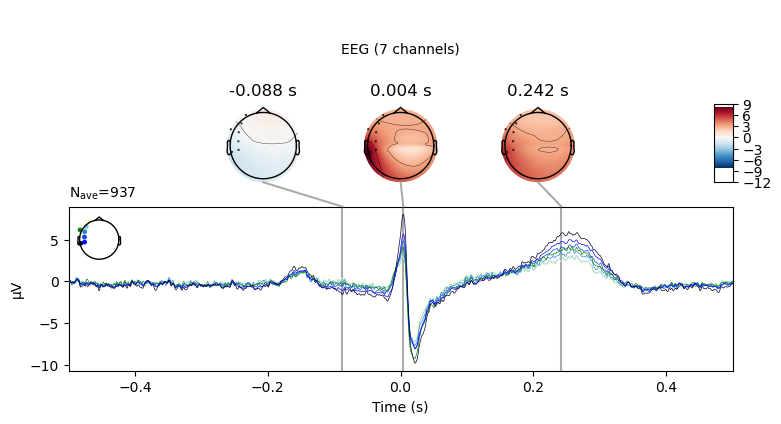

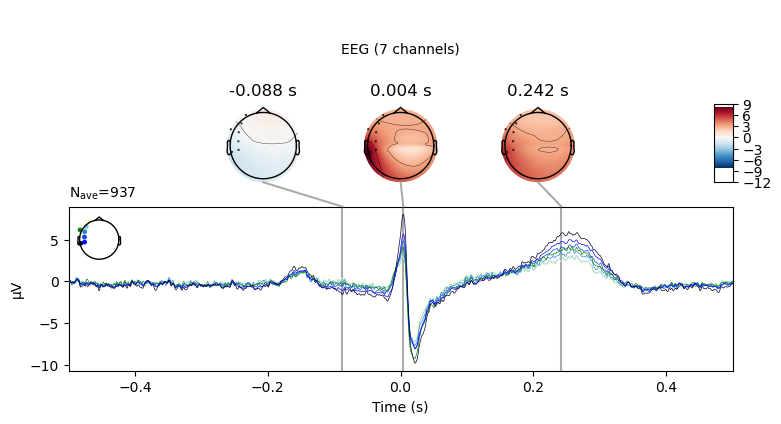

In [42]:
ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked
.apply_baseline(baseline=(None, None))
ecg_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 313 (average pulse 62 / min.)
Not setting metadata
313 matching events found
No baseline correction applied
Using data from preloaded Raw for 313 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


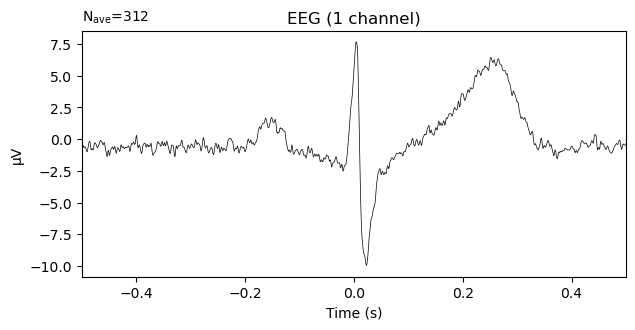

In [37]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_first_rest = create_ecg_epochs(ica_firstrest, picks=['TP9']).average()
ecg_evoked_first_rest.apply_baseline(baseline=(None, None))
ecg_evoked_first_rest.plot()
hev_data_first_rest = ecg_evoked_first_rest.get_data()
hev_data_first_rest = hev_data_first_rest.T
# ecg_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 312 (average pulse 62 / min.)
Not setting metadata
312 matching events found
No baseline correction applied
Using data from preloaded Raw for 312 events and 1001 original time points ...
0 bad epochs dropped
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


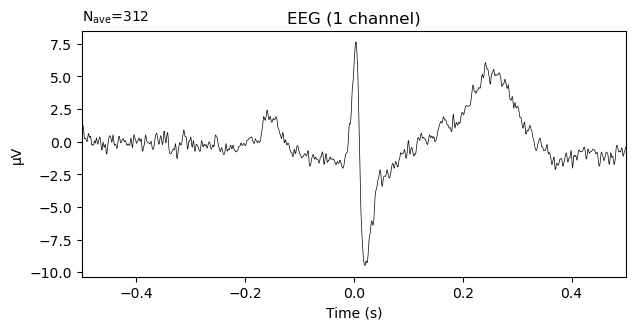

In [38]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_stress = create_ecg_epochs(ica_stress, picks=['TP9']).average()
ecg_evoked_stress.apply_baseline(baseline=(None, None))
ecg_evoked_stress.plot()
hev_data_stress = ecg_evoked_stress.get_data()
hev_data_stress = hev_data_stress.T
# ecg_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 310 (average pulse 61 / min.)
Not setting metadata
310 matching events found
No baseline correction applied
Using data from preloaded Raw for 310 events and 1001 original time points ...
0 bad epochs dropped
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


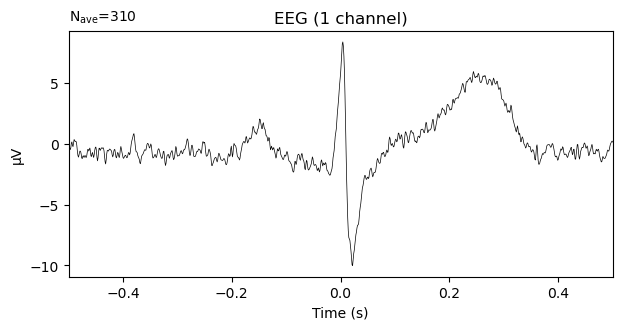

In [39]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_second_rest = create_ecg_epochs(ica_secondrest, picks=['TP9']).average()
ecg_evoked_second_rest.apply_baseline(baseline=(None, None))
ecg_evoked_second_rest.plot()
hev_data_second_rest = ecg_evoked_second_rest.get_data()
hev_data_second_rest = hev_data_second_rest.T
# ecg_evoked.plot_joint()

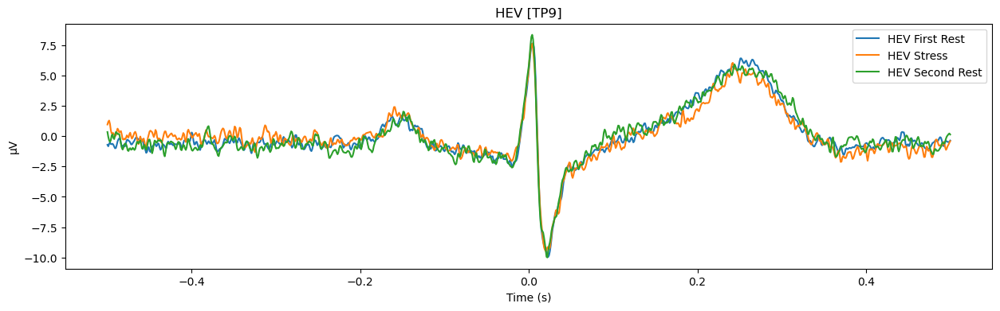

In [40]:
time_space = 0.001
epoch_time = np.arange(-0.5, 0.5+time_space, time_space) 
plt.figure(figsize = (15,4))
plt.title(label='HEV [TP9]')
plt.plot(epoch_time,hev_data_first_rest * 1000000, label = 'HEV First Rest')
plt.plot(epoch_time,hev_data_stress* 1000000, label = 'HEV Stress')
plt.plot(epoch_time,hev_data_second_rest* 1000000, label = 'HEV Second Rest')
plt.ylabel('μV')
plt.xlabel('Time (s)')
plt.legend()
plt.show()

## Others

In [21]:
epochs = mne.Epochs(reconst_raw,events=events, tmin=-0.2, tmax=1,preload=True)

Not setting metadata
180 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 180 events and 1201 original time points ...
11 bad epochs dropped


In [22]:
epochs = mne.Epochs(reconst_raw,events=events, picks = ['eeg'], reject=None, flat=None, reject_by_annotation=False, tmin=-0.2, tmax=1,preload=True)

Not setting metadata
180 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 180 events and 1201 original time points ...
11 bad epochs dropped


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    3.1s


NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


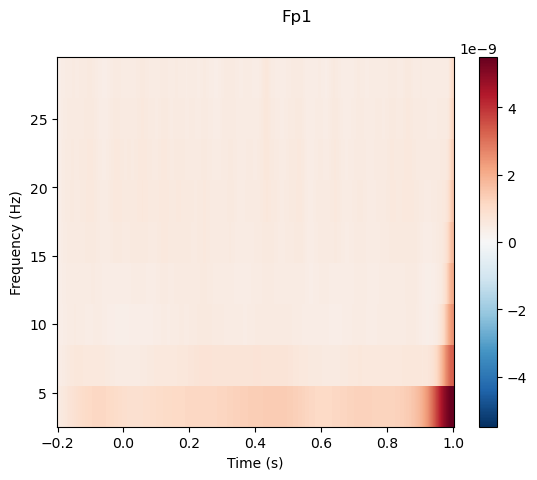

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


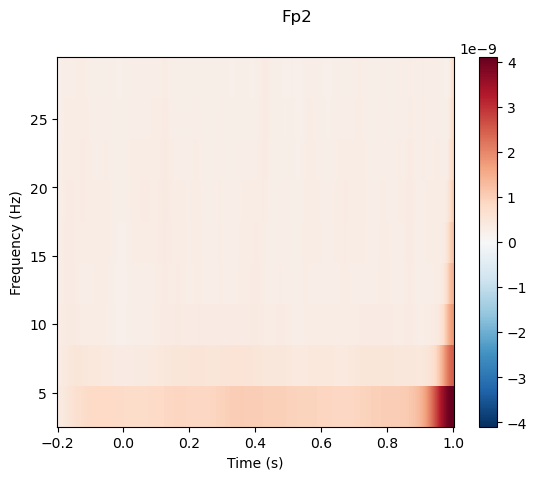

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


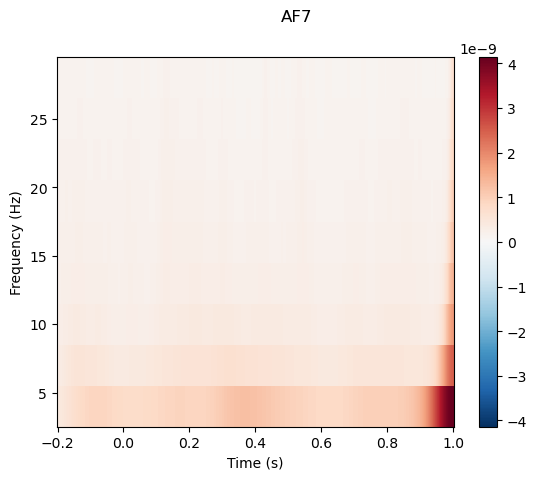

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


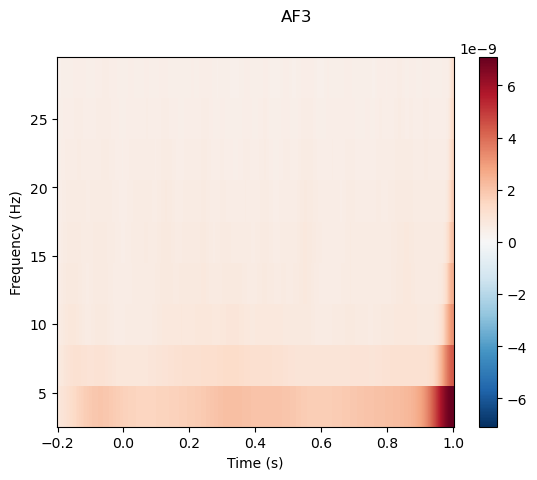

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


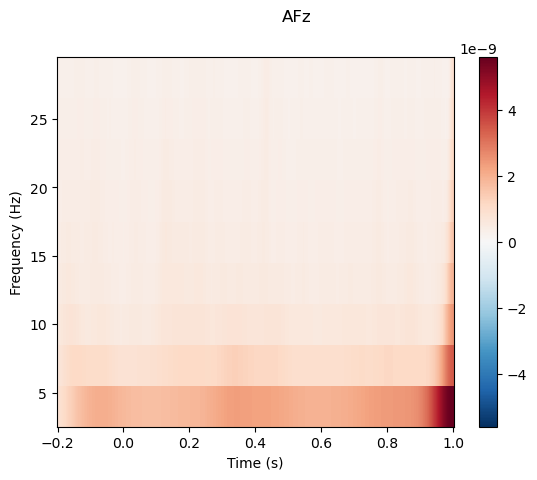

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


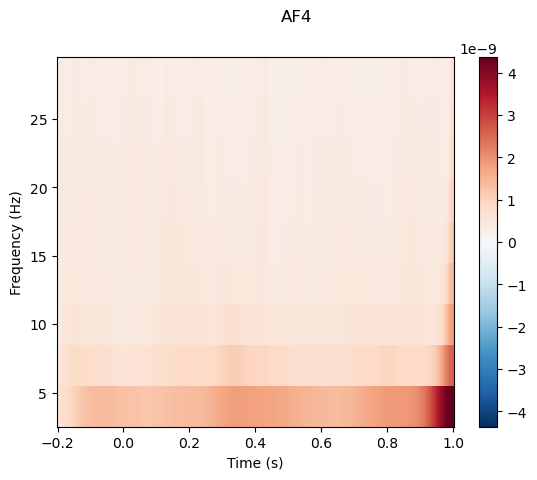

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


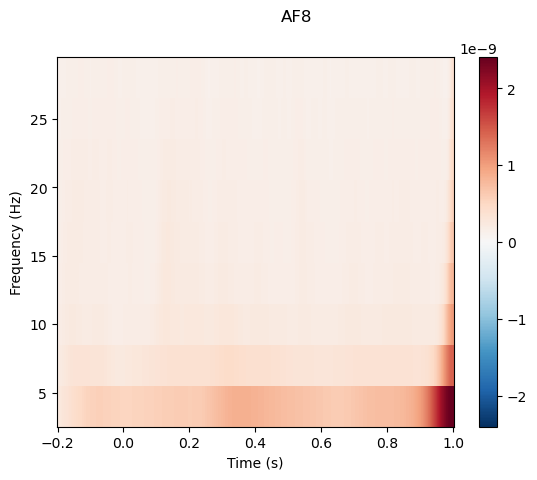

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


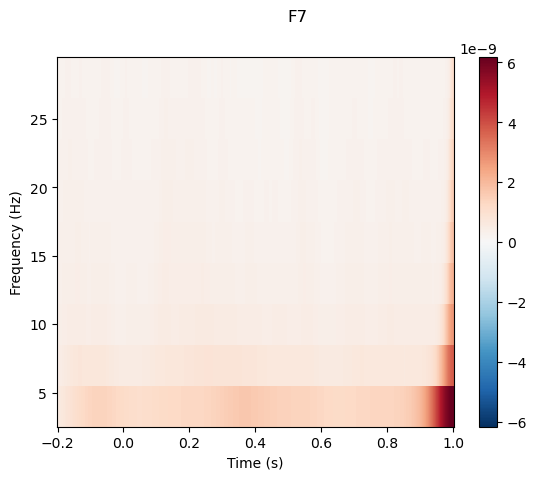

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


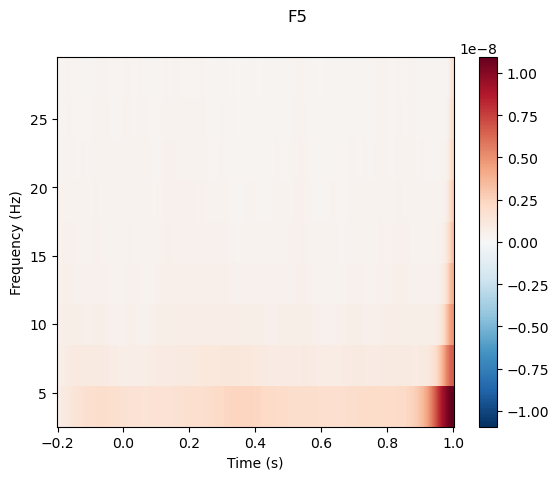

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


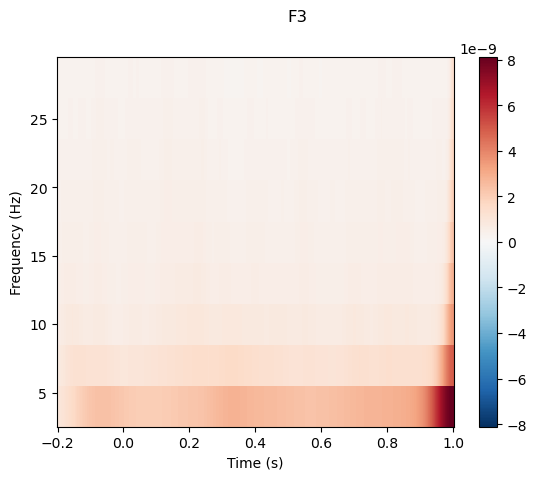

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


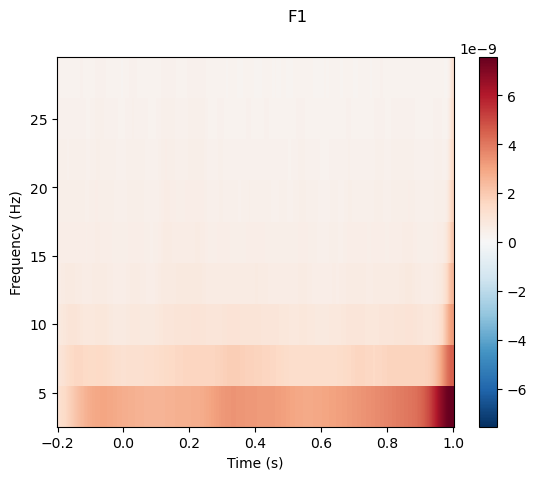

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


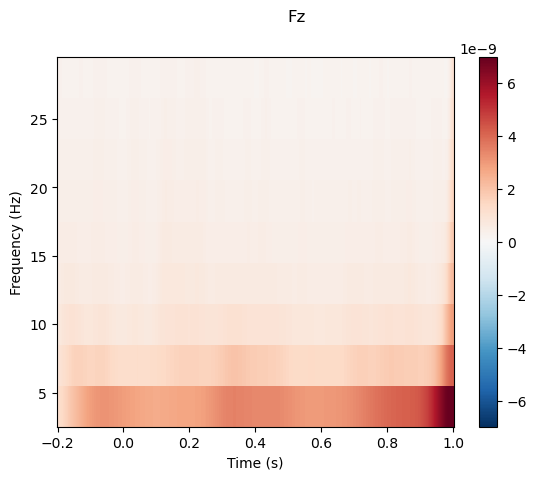

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


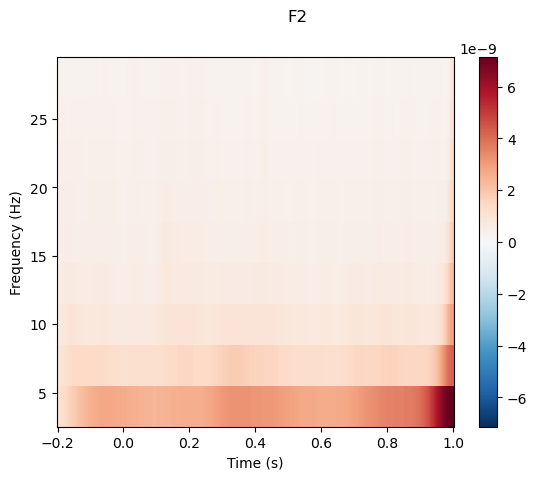

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


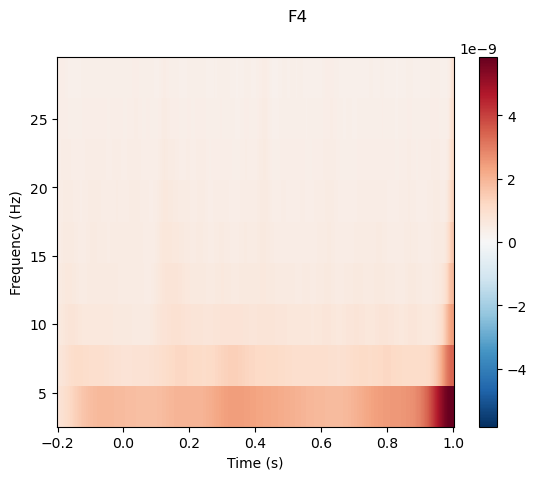

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


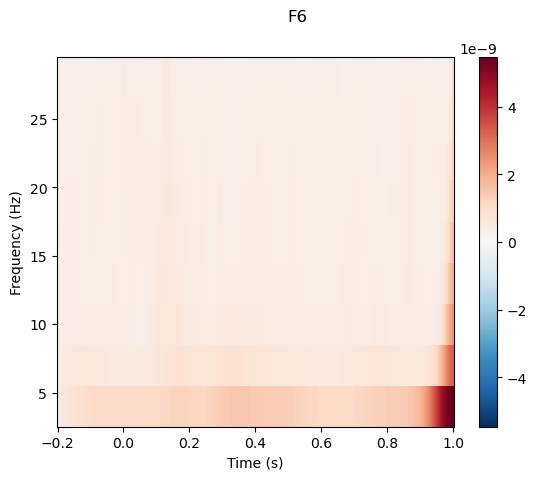

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


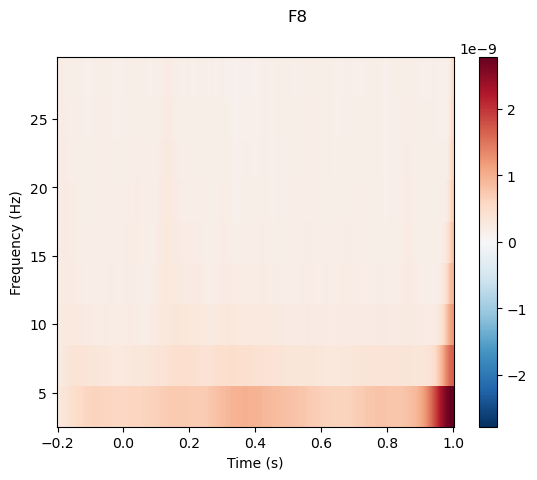

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


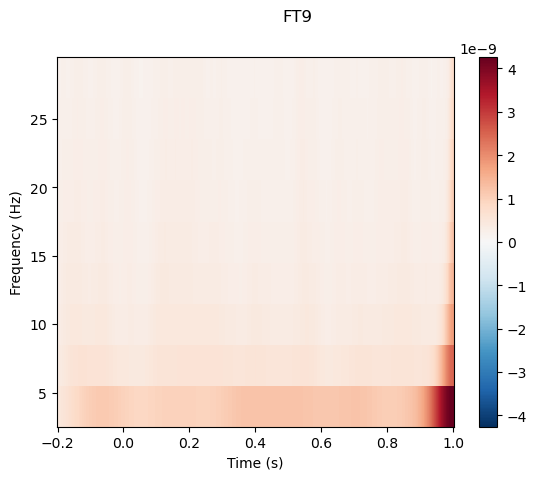

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


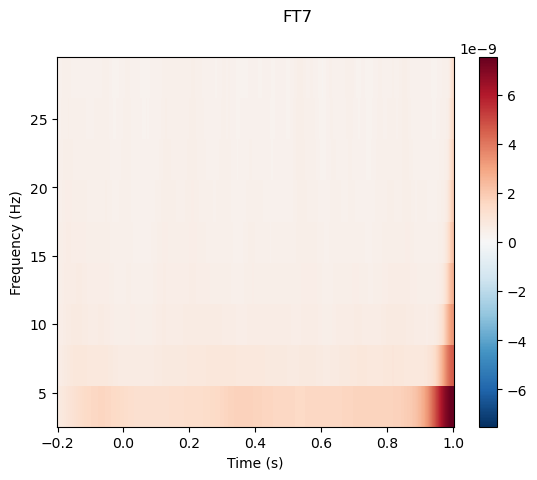

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


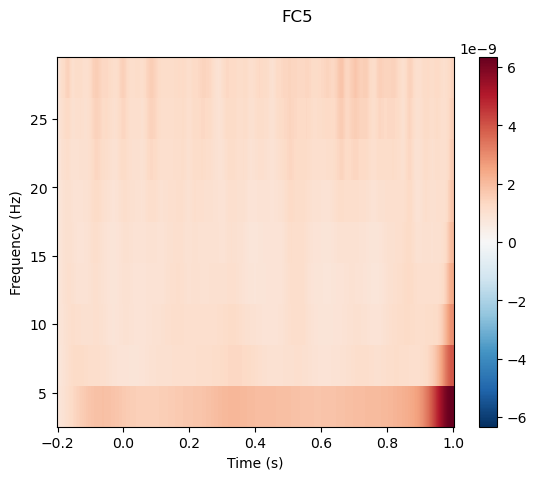

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


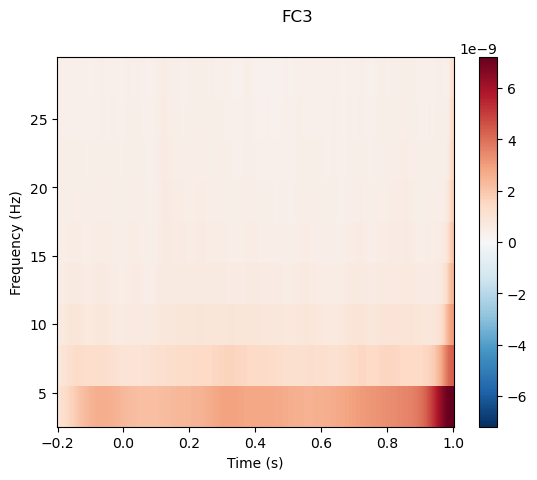

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


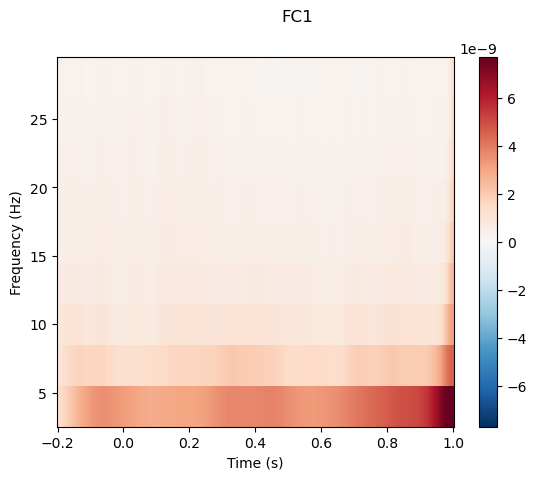

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


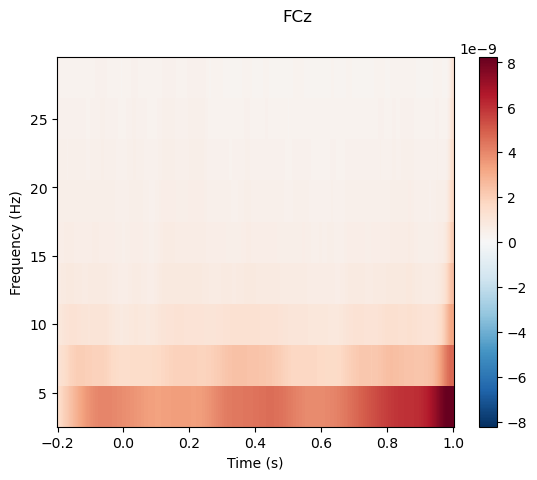

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


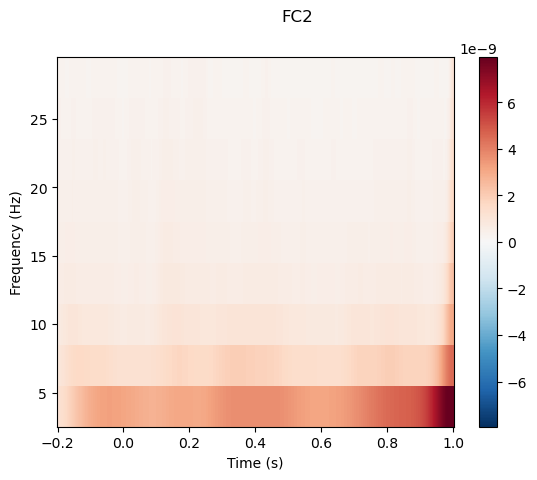

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


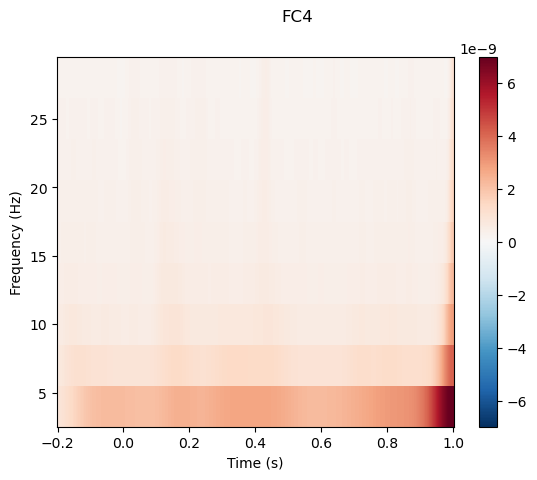

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


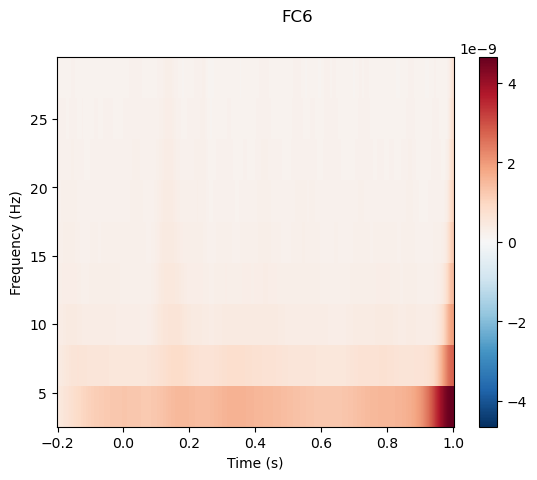

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


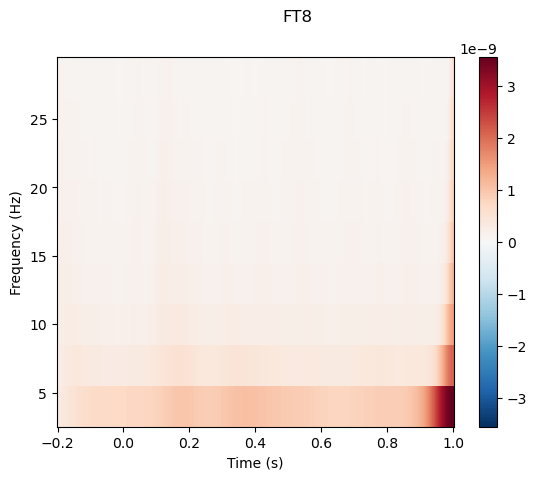

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


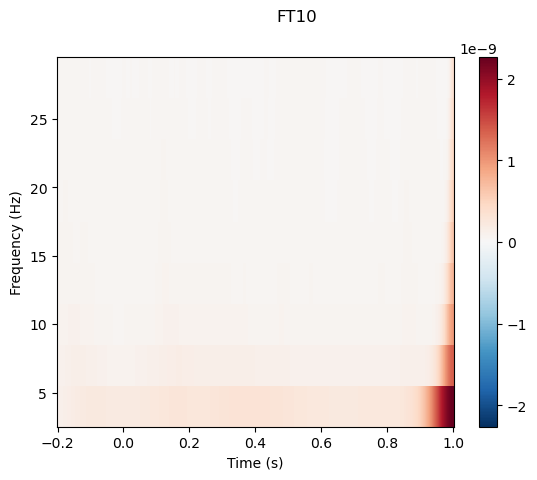

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


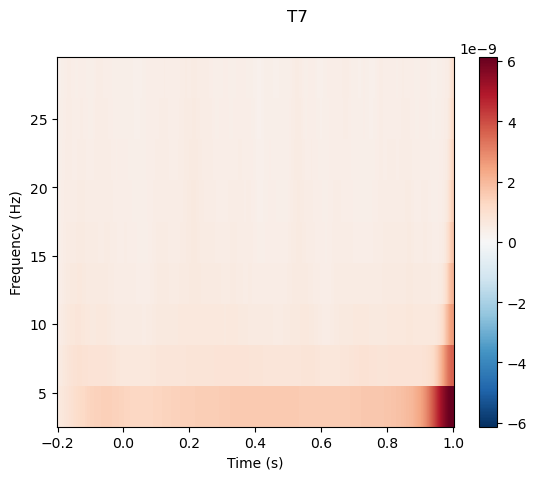

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


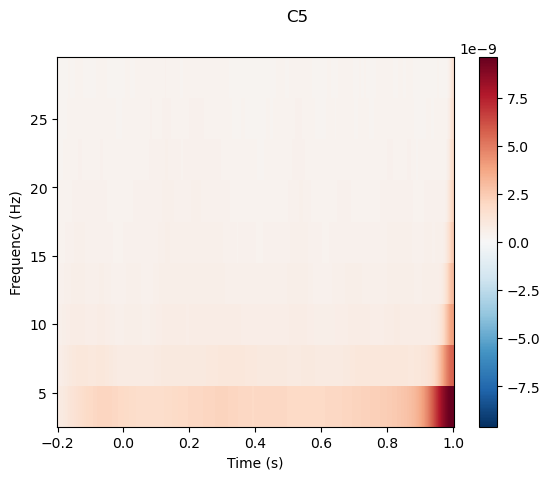

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


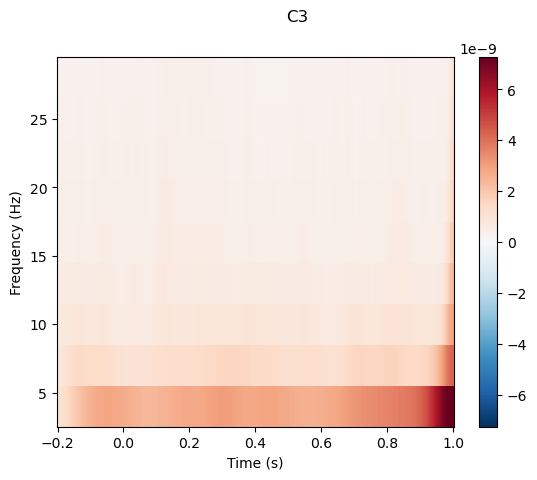

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


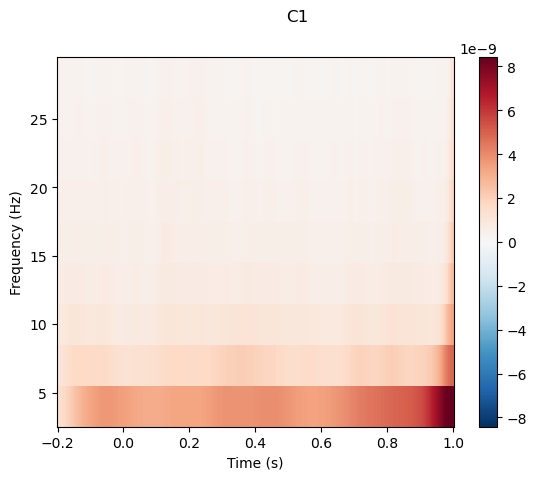

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


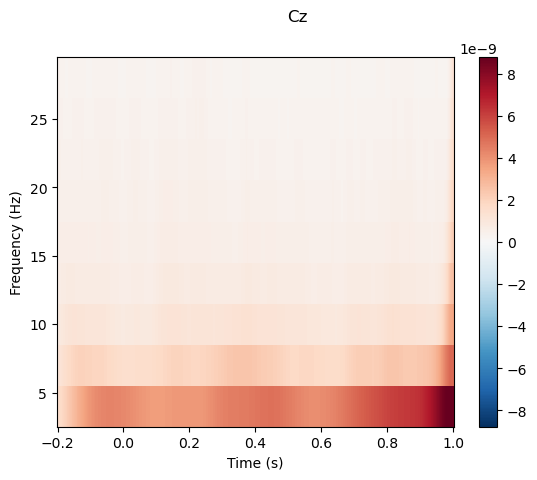

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


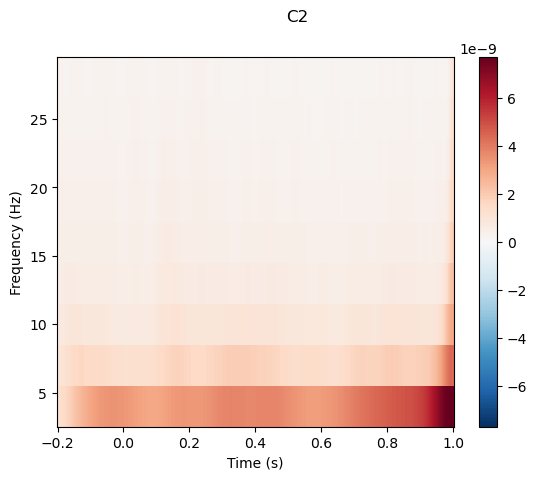

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


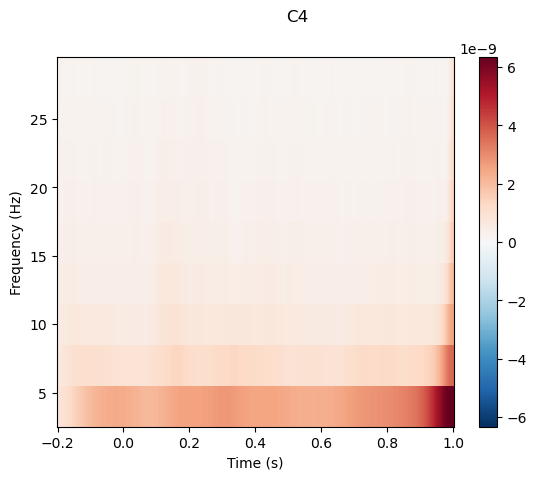

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


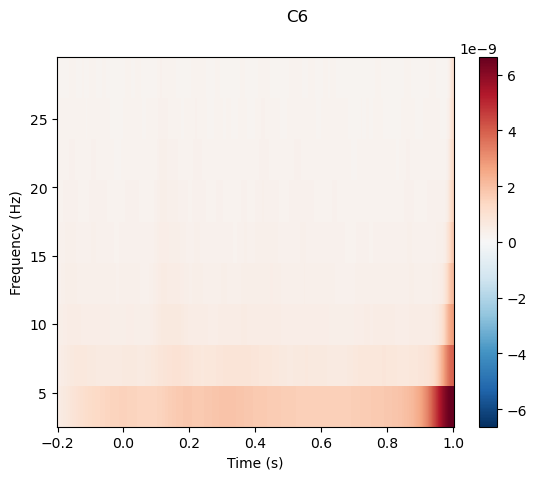

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


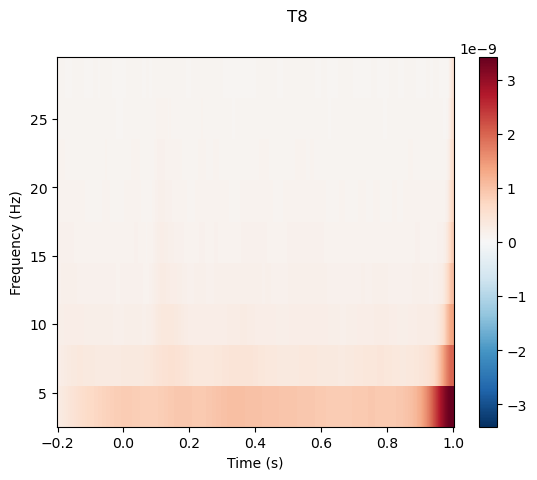

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


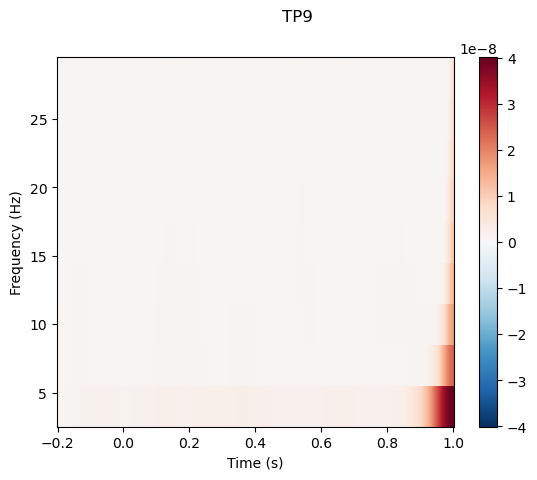

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


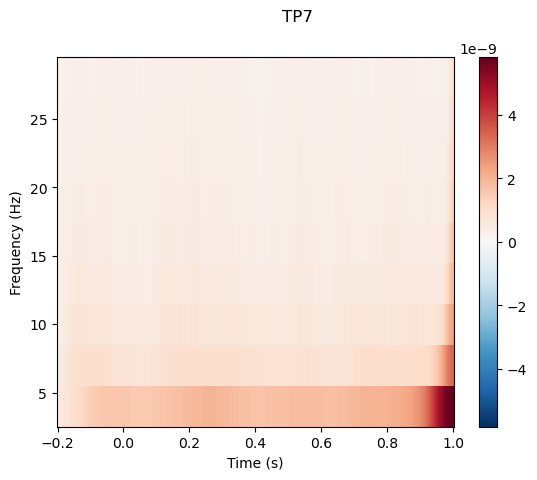

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


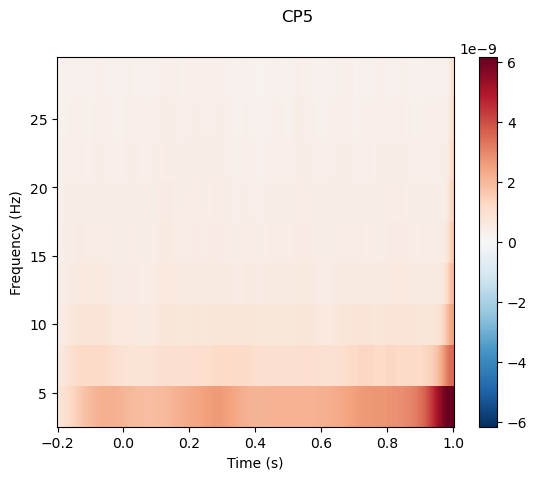

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


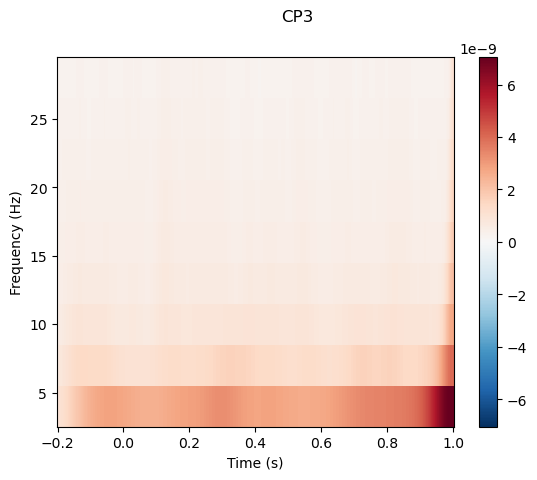

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


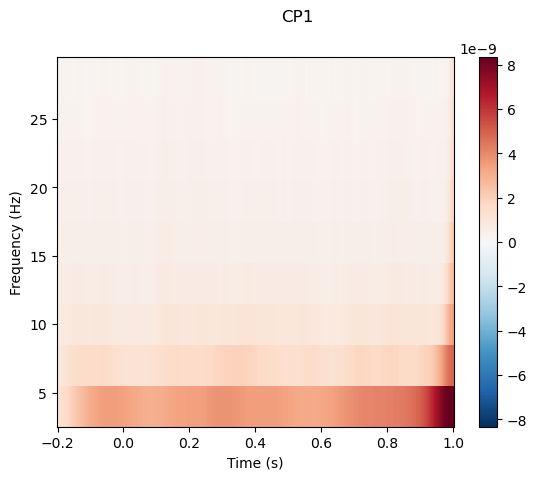

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


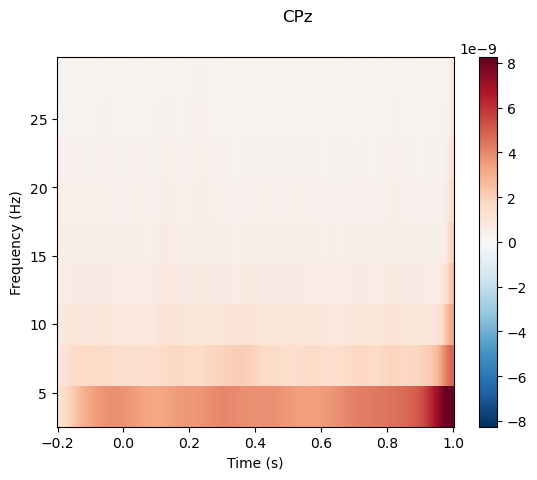

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


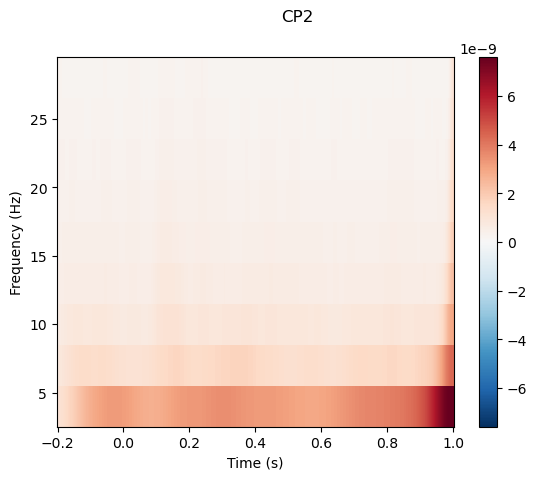

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


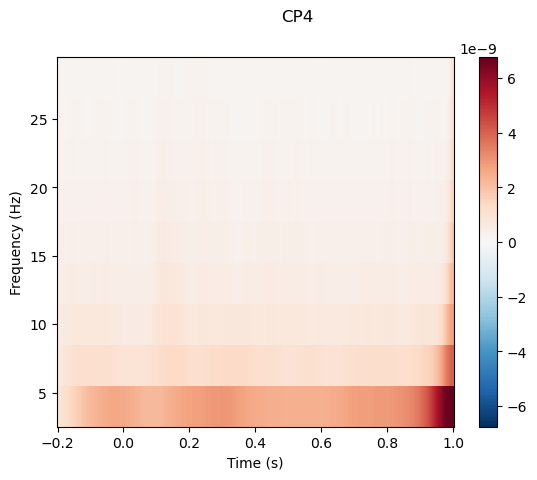

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


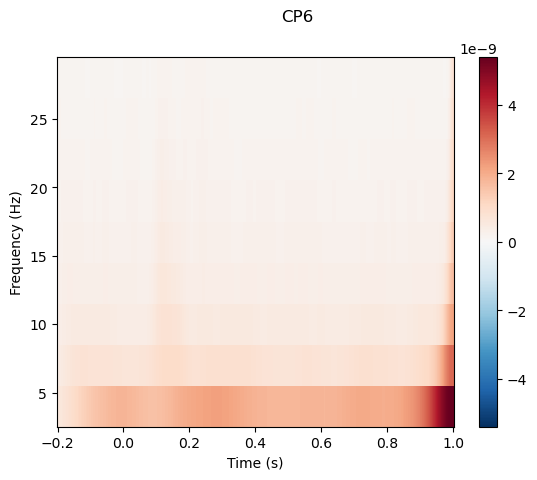

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


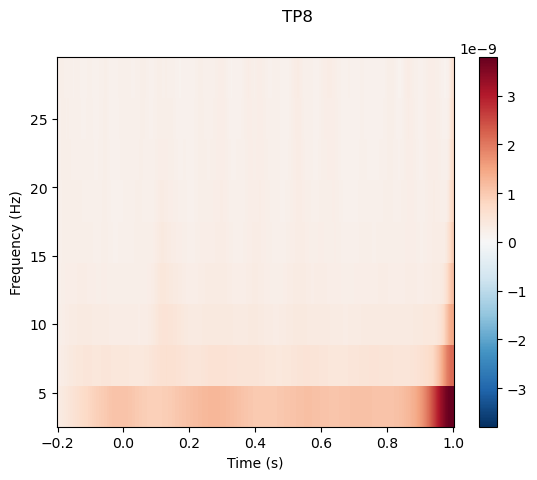

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


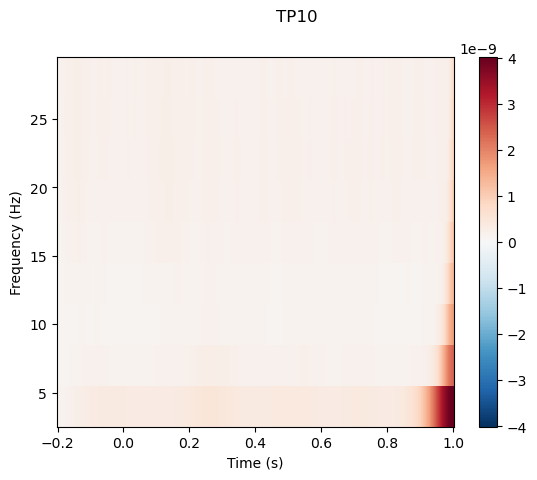

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


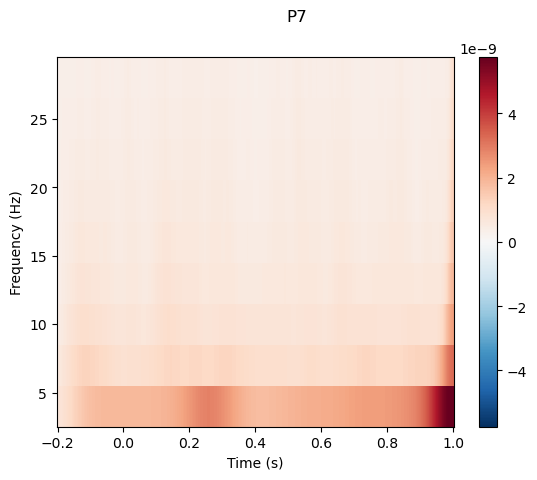

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


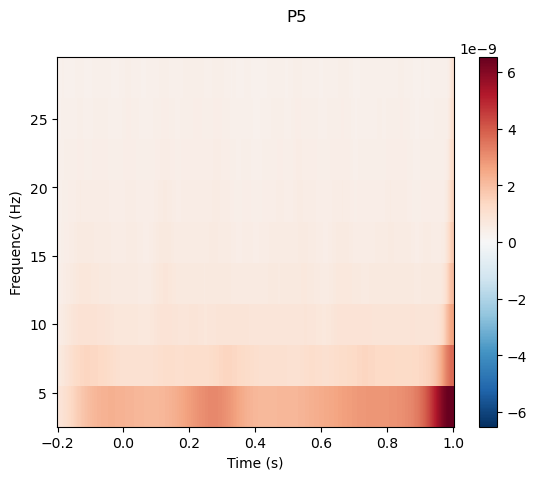

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


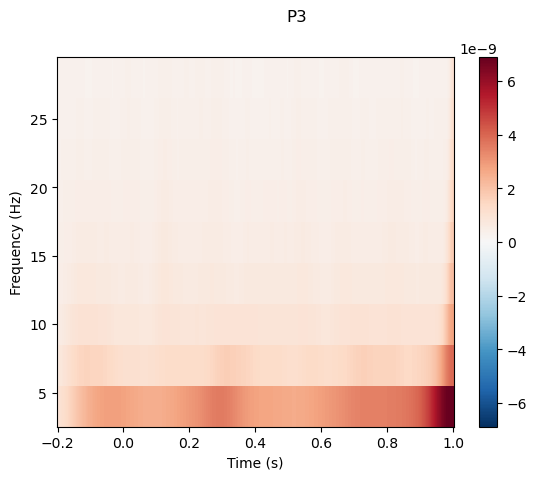

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


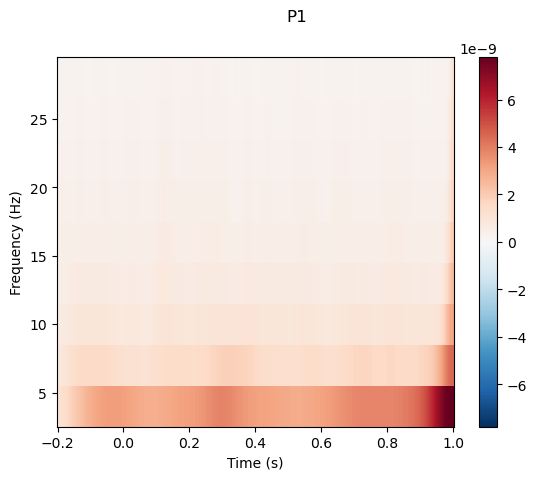

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


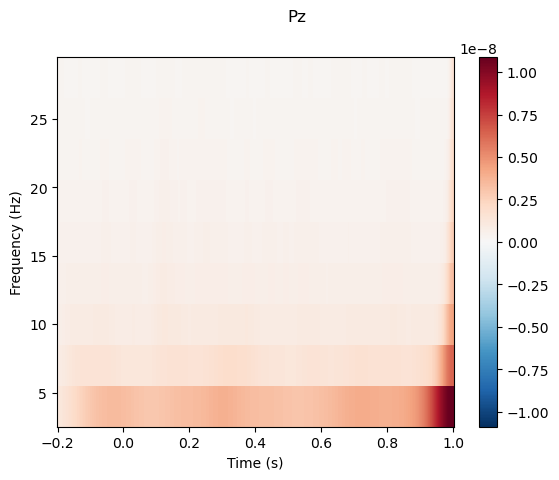

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


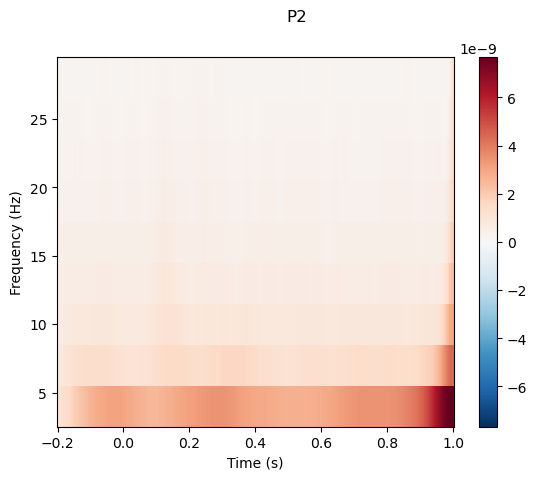

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


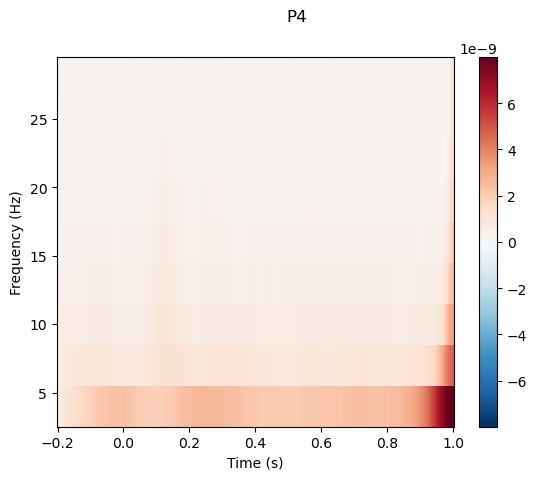

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


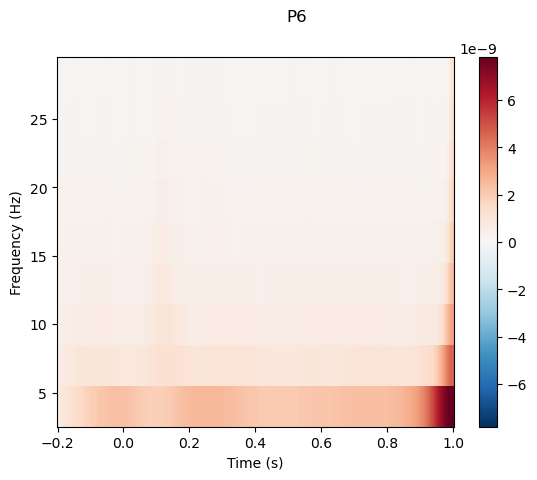

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


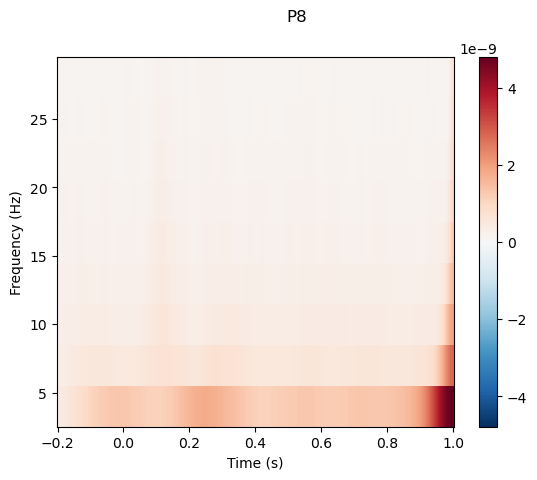

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


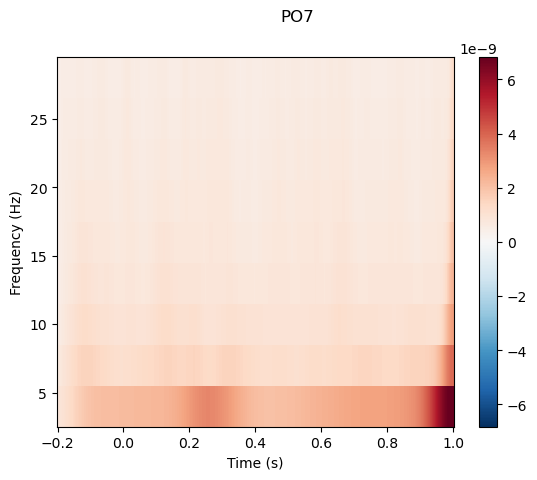

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


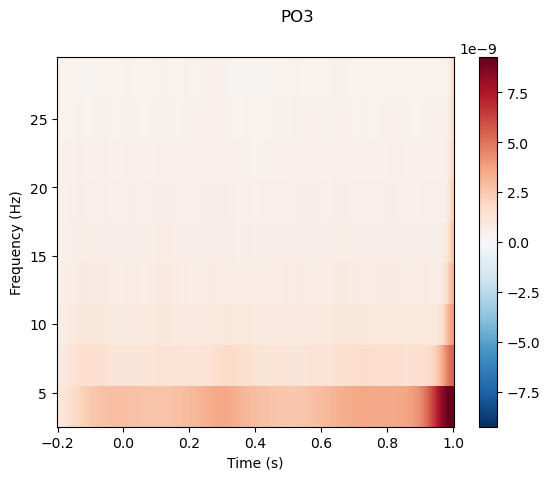

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


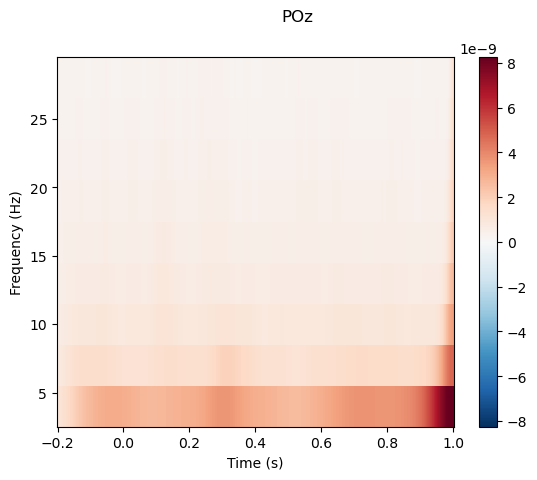

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


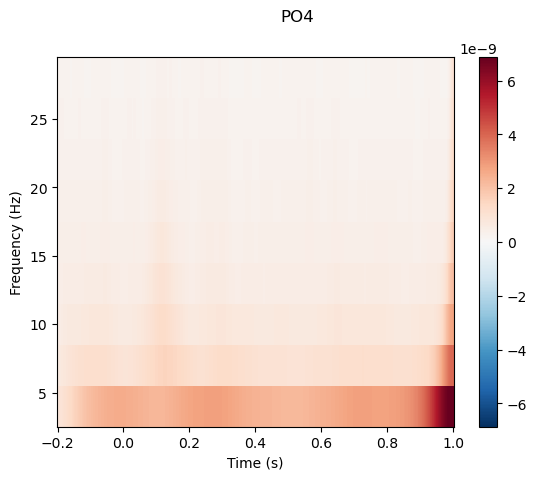

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


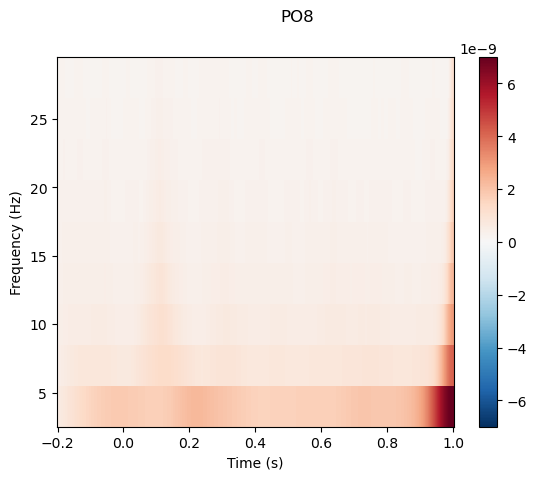

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


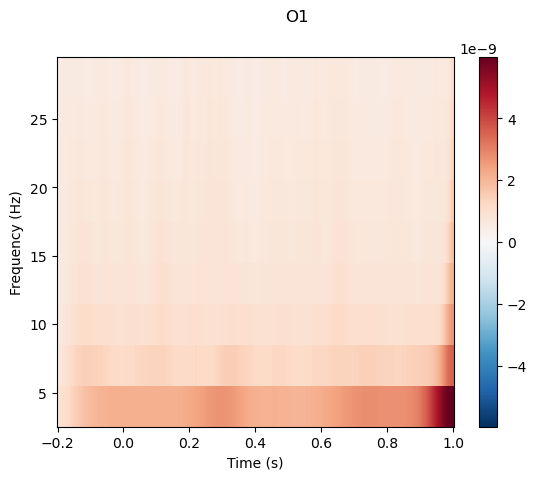

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


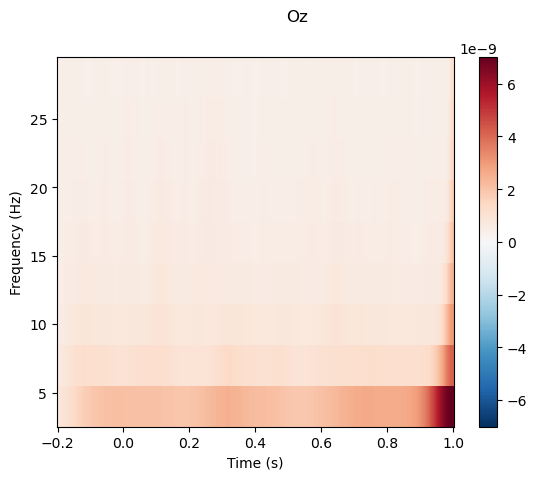

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


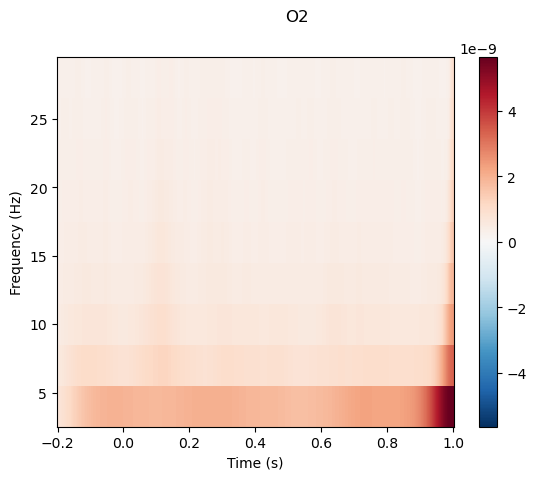

In [23]:
frequencies = np.arange(4, 30, 3)
power = mne.time_frequency.tfr_morlet(epochs, n_cycles=2, return_itc=False, freqs=frequencies, decim=3, average=True)

raw_eeg = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
ch_name_list = raw_eeg.ch_names

for i in range(len(ch_name_list)):
    ch = ch_name_list[i]
    power.plot(picks = str(ch), title = str(ch))

Effective window size : 1.201 (s)


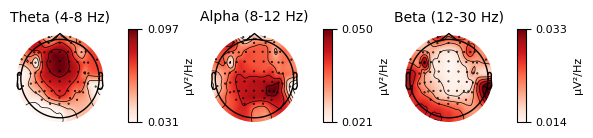

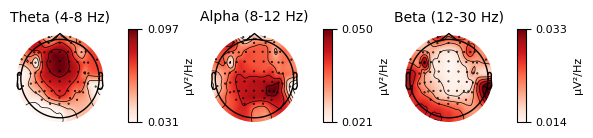

In [24]:
psd_epoch = epochs.compute_psd(method='welch',fmin=4,fmax=30,tmin=-0.2, tmax= 1, picks =['eeg'])
psd_epoch.plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30)}, normalize = True, ch_type='eeg', agg_fun=np.median)

In [25]:
eeg_temp = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
channel = eeg_temp.ch_names

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


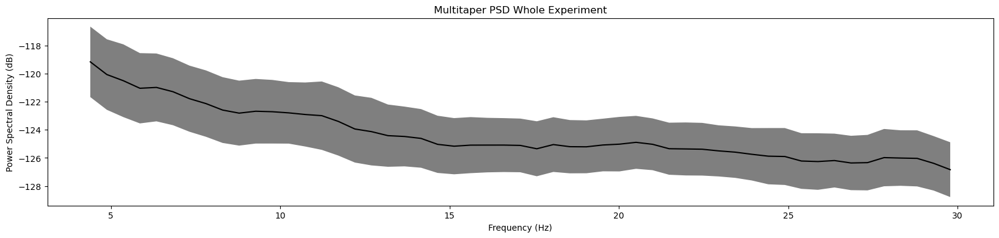

In [26]:
psds, freqs = eeg_psd.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Whole Experiment")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

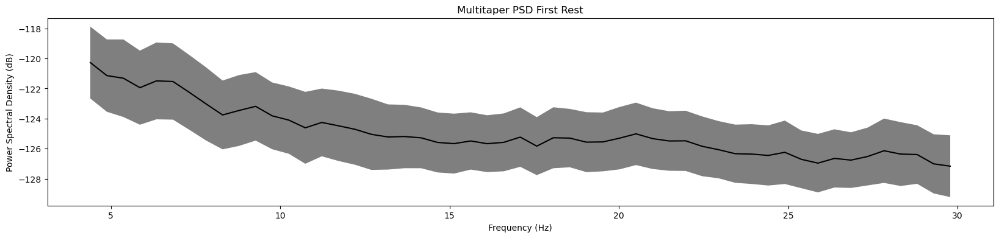

In [27]:
psds, freqs = psd_firstrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD First Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

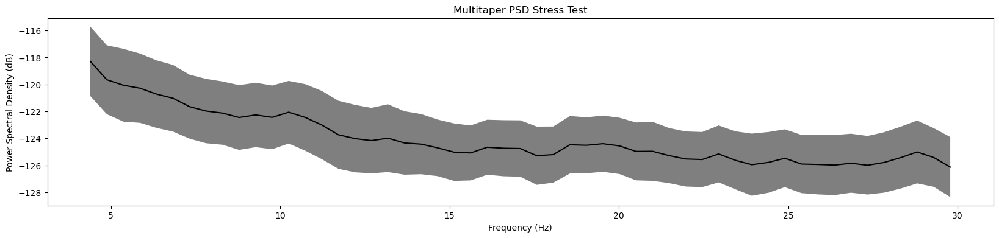

In [28]:
psds, freqs = psd_stress.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Stress Test")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

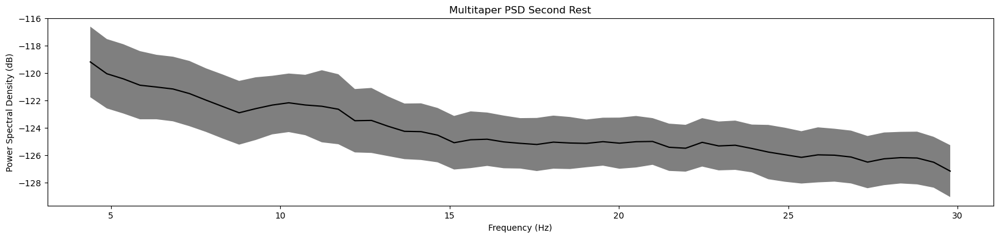

Channels marked as bad:
none
Channels marked as bad:
none


In [ ]:
psds, freqs = psd_secondrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Second Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)